# TLT Object detection example usecase

#### This notebook shows an example usecase of Object Detection using Transfer Learning Toolkit. **_It is not optimized for accuracy._**

0. [Set up env variables](#head-0)
1. [Prepare dataset and pre-trained model](#head-1)<br>
    1.1 [Convert to kitti format](#head-1-1)<br>
    1.2 [Prepare tf records from kitti format dataset](#head-1-2)<br>
    1.3 [Download pre-trained model](#head-1-3)<br>
2. [Provide training specfication](#head-2)
3. [Run TLT training](#head-3)
4. [Evaluate trained models](#head-4)
5. [Prune trained models](#head-5)
6. [Retrain pruned models](#head-6)
7. [Evaluate retrained model](#head-7)
8. [Test models](#head-8)
9. [Visualize inferences](#head-9)
10. [Deploy](#head-10)

## 0. Set up env variables <a class="anchor" id="head-0"></a>

Please replace the **$API_KEY** with your api key on **ngc.nvidia.com**

In [31]:
hello

NameError: name 'hello' is not defined

In [1]:
# Setting up env variables for cleaner command line commands.
print("Please replace the variable with your api key.")
%env API_KEY=aTk1bTNzdm9hamg5ZzZmaWM5aW1qczJ1Nmk6YWY1MDU3MDItNTU3NS00MzVmLWFjZWEtMTMxNWQ4NWIyMmRk
%env USER_EXPERIMENT_DIR=/data/tlt/workspace/
%env DATA_DOWNLOAD_DIR=/data/tlt/workspace/data
%env SPECS_DIR=/data/tlt/workspace/examples/specs

Please replace the variable with your api key.
env: API_KEY=aTk1bTNzdm9hamg5ZzZmaWM5aW1qczJ1Nmk6YWY1MDU3MDItNTU3NS00MzVmLWFjZWEtMTMxNWQ4NWIyMmRk
env: USER_EXPERIMENT_DIR=/data/tlt/workspace/
env: DATA_DOWNLOAD_DIR=/data/tlt/workspace/data
env: SPECS_DIR=/data/tlt/workspace/examples/specs


## 1. Prepare dataset and pre-trained model <a class="anchor" id="head-1"></a>

We will be using the pascal VOC dataset for the tutorial. To find more details please visit 
http://host.robots.ox.ac.uk/pascal/VOC/voc2012/index.html#devkit. Please download the dataset present at http://host.robots.ox.ac.uk/pascal/VOC/voc2012/VOCtrainval_11-May-2012.tar to $DATA_DOWNLOAD_DIR.

### 1.1 Convert to kitti format <a class="anchor" id="head-1-1"></a>

In [2]:
from voc_utils import convert_to_kitti
import os

image_width = 496
image_height = 320

DATA_DIR = os.environ['DATA_DOWNLOAD_DIR']
voc_root = DATA_DIR
convert_to_kitti(voc_root, image_height, image_width)

In [3]:
print(len(os.listdir(os.path.join(voc_root, 'Annotations_kitti/test'))))
print(len(os.listdir(os.path.join(voc_root, 'Annotations_kitti/trainval'))))

7902
27033


In [8]:
!ls $DATA_DOWNLOAD_DIR/Annotations_kitti/trainval | head 

train_5858bf2b-23d2-11e8-a6a3-ec086b02610b.txt
train_5858bf2c-23d2-11e8-a6a3-ec086b02610b.txt
train_5858bf35-23d2-11e8-a6a3-ec086b02610b.txt
train_5858bf4a-23d2-11e8-a6a3-ec086b02610b.txt
train_5858bf4d-23d2-11e8-a6a3-ec086b02610b.txt
train_5858bf5d-23d2-11e8-a6a3-ec086b02610b.txt
train_5858bf67-23d2-11e8-a6a3-ec086b02610b.txt
train_5858bf6a-23d2-11e8-a6a3-ec086b02610b.txt
train_5858bf6f-23d2-11e8-a6a3-ec086b02610b.txt
train_5858bf7c-23d2-11e8-a6a3-ec086b02610b.txt
ls: write error: Broken pipe


In [9]:
!cat $DATA_DOWNLOAD_DIR/Annotations_kitti/trainval/train_5858bf2b-23d2-11e8-a6a3-ec086b02610b.txt

squirrel 0.00 0 0.00 247.273 118.876 273.914 140.295 0.00 0.00 0.00 0.00 0.00 0.00 0.00


### 1.2 Prepare tf records from kitti format dataset <a class="anchor" id="head-1-2"></a>

* Update the tfrecords spec file to take in your kitti format dataset
* Create the tfrecords using the tlt-dataset-convert 
    * Note: The output directory should be created before hand to update place the tfrecords
* TFRecords only need to be generated once.

In [14]:
!$USER_EXPERIMENT_DIR

/bin/sh: 1: /data/tlt/workspace/: Permission denied


In [16]:
print("TFrecords conversion spec file for kitti training")
!cat $SPECS_DIR/det_tfrecords_pascal_voc_trainval.txt

TFrecords conversion spec file for kitti training
kitti_config {
  root_directory_path: "/data/tlt/workspace/data"
  image_dir_name: "JPEGImages_kitti/trainval"
  label_dir_name: "Annotations_kitti/trainval"
  image_extension: ".jpg"
  partition_mode: "random"
  val_split: 20
  num_shards: 10
}
image_directory_path: "/data/tlt/workspace/data"


In [24]:
!$USER_EXPERIMENT_DIR

/bin/sh: 1: /data/tlt/workspace/: Permission denied


In [17]:
# Creating a new directory for the output tfrecords dump.
!mkdir -p $USER_EXPERIMENT_DIR/tfrecords/pascal_voc
!tlt-dataset-convert -d $SPECS_DIR/det_tfrecords_pascal_voc_trainval.txt \
                     -o $USER_EXPERIMENT_DIR/tfrecords/pascal_voc/pascal_voc

Using TensorFlow backend.
2019-04-15 06:52:32,391 - iva.dashnet.dataio.build_converter - INFO - Instantiating a kitti converter
2019-04-15 06:52:32,485 - iva.dashnet.dataio.kitti_converter_lib - INFO - Num images in
Train: 21627	Val: 5406
2019-04-15 06:52:32,485 - iva.dashnet.dataio.kitti_converter_lib - INFO - Validation data in partition 0. Hence, while choosing the validationset during training choose validation_fold 0.
2019-04-15 06:52:32,494 - dlav.drivenet.dataio.dataset_converter_lib - INFO - Writing partition 0, shard 0
/usr/local/lib/python2.7/dist-packages/iva/dashnet/dataio/kitti_converter_lib.py:255: VisibleDeprecationWarning: Reading unicode strings without specifying the encoding argument is deprecated. Set the encoding, use None for the system default.
2019-04-15 06:52:33,076 - dlav.drivenet.dataio.dataset_converter_lib - INFO - Writing partition 0, shard 1
2019-04-15 06:52:33,711 - dlav.drivenet.dataio.dataset_converter_lib - INFO - Writing partition 0, shard 2
2019-04-

In [18]:
!ls -rlt $USER_EXPERIMENT_DIR/tfrecords/pascal_voc/

total 17484
-rw-r--r-- 1 root root  356530 Apr 15 06:52 pascal_voc-fold-000-of-002-shard-00000-of-00010
-rw-r--r-- 1 root root  356928 Apr 15 06:52 pascal_voc-fold-000-of-002-shard-00001-of-00010
-rw-r--r-- 1 root root  357532 Apr 15 06:52 pascal_voc-fold-000-of-002-shard-00002-of-00010
-rw-r--r-- 1 root root  356983 Apr 15 06:52 pascal_voc-fold-000-of-002-shard-00003-of-00010
-rw-r--r-- 1 root root  357296 Apr 15 06:52 pascal_voc-fold-000-of-002-shard-00004-of-00010
-rw-r--r-- 1 root root  357598 Apr 15 06:52 pascal_voc-fold-000-of-002-shard-00005-of-00010
-rw-r--r-- 1 root root  356995 Apr 15 06:52 pascal_voc-fold-000-of-002-shard-00006-of-00010
-rw-r--r-- 1 root root  356142 Apr 15 06:52 pascal_voc-fold-000-of-002-shard-00007-of-00010
-rw-r--r-- 1 root root  357090 Apr 15 06:52 pascal_voc-fold-000-of-002-shard-00008-of-00010
-rw-r--r-- 1 root root  361725 Apr 15 06:52 pascal_voc-fold-000-of-002-shard-00009-of-00010
-rw-r--r-- 1 root root 1427753 Apr 15 06:52 pascal_voc-fold-001-of-0

### 1.3 Download pre-trained model <a class="anchor" id="head-1-3"></a>

Print the list of models. Find your **ORG** and **TEAM** on **ngc.nvidia.com** and replace the **-o** and **-t** arguments.  

In [19]:
!tlt-pull -k $API_KEY -lm -o nvtltea -t iva

+----------+----------+---------+----------+----------+----------+----------+
| Name     | Org/Team | Latest  | Applicat | Framewor | Precisio | Last     |
|          |          | Version | ion      | k        | n        | Modified |
+----------+----------+---------+----------+----------+----------+----------+
| tlt_iva_ | nvtltea/ | 1       | Classifi | TLT      | FP32     | 2019-03- |
| classifi | iva      |         | cation   |          |          | 01       |
| cation_a |          |         |          |          |          | 20:41:41 |
| lexnet   |          |         |          |          |          | UTC      |
| tlt_iva_ | nvtltea/ | 1       | Classifi | TLT      | FP32     | 2019-03- |
| classifi | iva      |         | cation   |          |          | 02       |
| cation_g |          |         |          |          |          | 00:08:48 |
| ooglenet |          |         |          |          |          | UTC      |
| tlt_iva_ | nvtltea/ | 1       | Classifi | TLT      | FP32    

In [20]:
!mkdir -p $USER_EXPERIMENT_DIR/pretrained_resnet18/

Download the resnet18 object detection model.

In [21]:
# Pull pretrained model from NGC
!tlt-pull -k $API_KEY -m tlt_iva_object_detection_resnet18 -v 1 -d $USER_EXPERIMENT_DIR/pretrained_resnet18/ -o nvtltea -t iva

Downloaded 42.16 MB in 4s, Download speed: 10.51 MB/s               
----------------------------------------------------
Transfer id: tlt_iva_object_detection_resnet18_v1 Download status: Completed.
Downloaded local path: /tmp/tmpLieVb7/tlt_iva_object_detection_resnet18_v1
Total files downloaded: 2 
Total downloaded size: 42.16 MB
Started at: 2019-04-15 06:54:23.695294
Completed at: 2019-04-15 06:54:27.705753
Duration taken: 4s seconds
----------------------------------------------------
Finished downloading tlt_iva_object_detection_resnet18


In [22]:
!ls -rlt $USER_EXPERIMENT_DIR/pretrained_resnet18

total 45388
-rw-r--r-- 1 root root      250 Apr 15 06:54 license.txt
-rw-r--r-- 1 root root 46470680 Apr 15 06:54 resnet18_kitti_multiclass_v1.tlt


## 2. Provide training specfication <a class="anchor" id="head-2"></a>
* Tfrecords for the train datasets
    * Inorder to use the newly generated tfrecords, update the dataset_config parameter in the spec file at `$SPECS_DIR/train_resnet18_spec.txt` 
    * Update the fold number to use for evaluation. In case of random data split, please use fold 0 only
    * For sequence wise you may use any fold generated from the dataset convert tool
* Pre-trained models
* Augmentation parameters for on the fly data augmentation
* Other training (hyper-)parameters such as batch size, number of epochs, learning rate etc.

In [28]:
!cat $SPECS_DIR/det_train_resnet18_pascal_voc_Caltech.txt

random_seed: 42
model_config {
  template: "resnet"
  num_layers: 18
  use_pooling: False
  use_batch_norm: True
  dropout_rate: 0.0
  training_precision: {
    backend_floatx: FLOAT32
  }
  objective_set: {
    cov {}
    bbox {
      scale: 35.0
      offset: 0.5
    }
  }
}
bbox_rasterizer_config {
  target_class_config {
    key: "car"
    value: {
      cov_center_x: 0.5
      cov_center_y: 0.5
      cov_radius_x: 1.0
      cov_radius_y: 1.0
      bbox_min_radius: 1.0
    }
  }
  target_class_config {
    key: "fox"
    value: {
      cov_center_x: 0.5
      cov_center_y: 0.5
      cov_radius_x: 1.0
      cov_radius_y: 1.0
      bbox_min_radius: 1.0
    }
  }
  target_class_config {
    key: "squirrel"
    value: {
      cov_center_x: 0.5
      cov_center_y: 0.5
      cov_radius_x: 1.0
      cov_radius_y: 1.0
      bbox_min_radius: 1.0
    }
  }
  target_class_config {
    key: "deer"
    value: {
      cov_center_x: 0.5
      cov_center_y: 0.5
      cov_radius_x: 1.0
      cov_ra

## 3. Run TLT training <a class="anchor" id="head-3"></a>
* Provide the sample spec file and the output directory location for models

#### The training can take several hours to complete depending on your GPU.

In [34]:
!tlt-train detection -e $SPECS_DIR/det_train_resnet18_pascal_voc_Caltech.txt \
                     -r $USER_EXPERIMENT_DIR/experiment_dir_unpruned \
                     -k $API_KEY \
                     -n resnet18_detector

Using TensorFlow backend.
--------------------------------------------------------------------------
[[36889,1],0]: A high-performance Open MPI point-to-point messaging module
was unable to find any relevant network interfaces:

Module: OpenFabrics (openib)
  Host: 3ec374a39cc0

Another transport will be used instead, although this may result in
lower performance.

NOTE: You can disable this warning by setting the MCA parameter
btl_base_warn_component_unused to 0.
--------------------------------------------------------------------------
2019-04-17 02:04:59.756468: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:898] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2019-04-17 02:04:59.756940: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1356] Found device 0 with properties: 
name: Tesla V100-SXM2-16GB major: 7 minor: 0 memoryClockRate(GHz): 1.53
pciBusID: 0000:00:1e.0
totalMemory: 15.75GiB f

target/truncation is not updated to match the crop areaif the dataset contains target/truncation.
target/truncation is not updated to match the crop areaif the dataset contains target/truncation.
target/truncation is not updated to match the crop areaif the dataset contains target/truncation.
target/truncation is not updated to match the crop areaif the dataset contains target/truncation.
target/truncation is not updated to match the crop areaif the dataset contains target/truncation.
target/truncation is not updated to match the crop areaif the dataset contains target/truncation.
target/truncation is not updated to match the crop areaif the dataset contains target/truncation.
target/truncation is not updated to match the crop areaif the dataset contains target/truncation.
target/truncation is not updated to match the crop areaif the dataset contains target/truncation.
target/truncation is not updated to match the crop areaif the dataset contains target/truncation.
target/truncation is

INFO:tensorflow:loss = 0.043203343, epoch = 0.0014792899408284023, step = 1 (38.495 sec)
2019-04-17 02:10:08,476 [INFO] tensorflow: loss = 0.043203343, epoch = 0.0014792899408284023, step = 1 (38.495 sec)
INFO:tensorflow:loss = 0.04142426, epoch = 0.004437869822485207, step = 3 (14.361 sec)
2019-04-17 02:10:22,837 [INFO] tensorflow: loss = 0.04142426, epoch = 0.004437869822485207, step = 3 (14.361 sec)
INFO:tensorflow:loss = 0.027379291, epoch = 0.029585798816568046, step = 20 (5.503 sec)
2019-04-17 02:10:28,340 [INFO] tensorflow: loss = 0.027379291, epoch = 0.029585798816568046, step = 20 (5.503 sec)
2019-04-17 02:10:29,441 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 10.425
INFO:tensorflow:loss = 0.017008854, epoch = 0.05769230769230769, step = 39 (5.298 sec)
2019-04-17 02:10:33,638 [INFO] tensorflow: loss = 0.017008854, epoch = 0.05769230769230769, step = 39 (5.298 sec)
2019-04-17 02:10:36,424 [INFO] /

INFO:tensorflow:loss = 0.0018919155, epoch = 0.6449704142011834, step = 436 (5.316 sec)
2019-04-17 02:12:37,566 [INFO] tensorflow: loss = 0.0018919155, epoch = 0.6449704142011834, step = 436 (5.316 sec)
2019-04-17 02:12:41,123 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 114.685
INFO:tensorflow:loss = 0.0020286476, epoch = 0.6745562130177515, step = 456 (5.557 sec)
2019-04-17 02:12:43,123 [INFO] tensorflow: loss = 0.0020286476, epoch = 0.6745562130177515, step = 456 (5.557 sec)
INFO:tensorflow:global_step/sec: 3.61154
2019-04-17 02:12:46,752 [INFO] tensorflow: global_step/sec: 3.61154
2019-04-17 02:12:48,223 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 112.675
INFO:tensorflow:loss = 0.001916095, epoch = 0.7026627218934911, step = 475 (5.358 sec)
2019-04-17 02:12:48,482 [INFO] tensorflow: loss = 0.001916095, epoch = 0.7026627

INFO:tensorflow:global_step/sec: 3.67479
2019-04-17 02:14:40,808 [INFO] tensorflow: global_step/sec: 3.67479
2019-04-17 02:14:41,581 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 120.292
INFO:tensorflow:loss = 0.0006042558, epoch = 1.294378698224852, step = 875 (5.278 sec)
2019-04-17 02:14:41,842 [INFO] tensorflow: loss = 0.0006042558, epoch = 1.294378698224852, step = 875 (5.278 sec)
INFO:tensorflow:loss = 0.0005882597, epoch = 1.3239644970414202, step = 895 (5.528 sec)
2019-04-17 02:14:47,370 [INFO] tensorflow: loss = 0.0005882597, epoch = 1.3239644970414202, step = 895 (5.528 sec)
2019-04-17 02:14:48,486 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 115.860
INFO:tensorflow:loss = 0.0005913585, epoch = 1.3535502958579881, step = 915 (5.617 sec)
2019-04-17 02:14:52,987 [INFO] tensorflow: loss = 0.0005913585, epoch = 1.3535502

2019-04-17 02:16:45,188 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 116.690
INFO:tensorflow:loss = 0.00059445895, epoch = 1.967455621301775, step = 1330 (5.273 sec)
2019-04-17 02:16:46,884 [INFO] tensorflow: loss = 0.00059445895, epoch = 1.967455621301775, step = 1330 (5.273 sec)
INFO:tensorflow:global_step/sec: 3.6162
2019-04-17 02:16:49,494 [INFO] tensorflow: global_step/sec: 3.6162
2019-04-17 02:16:51,915 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 118.914
INFO:tensorflow:loss = 0.0005926684, epoch = 1.997041420118343, step = 1350 (5.286 sec)
2019-04-17 02:16:52,170 [INFO] tensorflow: loss = 0.0005926684, epoch = 1.997041420118343, step = 1350 (5.286 sec)
INFO:tensorflow:Saving checkpoints for step-1353.
2019-04-17 02:16:53,542 [INFO] tensorflow: Saving checkpoints for step-1353.
2019-04-17 02:16:54,184 [INFO] /usr/loca

INFO:tensorflow:global_step/sec: 3.63338
2019-04-17 02:18:41,528 [INFO] tensorflow: global_step/sec: 3.63338
2019-04-17 02:18:43,436 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 114.327
INFO:tensorflow:loss = 0.00059864373, epoch = 2.603550295857988, step = 1760 (5.529 sec)
2019-04-17 02:18:46,448 [INFO] tensorflow: loss = 0.00059864373, epoch = 2.603550295857988, step = 1760 (5.529 sec)
2019-04-17 02:18:50,218 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 117.966
INFO:tensorflow:loss = 0.0005994506, epoch = 2.633136094674556, step = 1780 (5.401 sec)
2019-04-17 02:18:51,849 [INFO] tensorflow: loss = 0.0005994506, epoch = 2.633136094674556, step = 1780 (5.401 sec)
2019-04-17 02:18:56,926 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 119.267
INFO:t

INFO:tensorflow:loss = 0.0005877343, epoch = 3.1997041420118344, step = 2163 (5.617 sec)
2019-04-17 02:20:46,145 [INFO] tensorflow: loss = 0.0005877343, epoch = 3.1997041420118344, step = 2163 (5.617 sec)
2019-04-17 02:20:49,711 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 97.343
INFO:tensorflow:loss = 0.00059209194, epoch = 3.224852071005917, step = 2180 (5.440 sec)
2019-04-17 02:20:51,585 [INFO] tensorflow: loss = 0.00059209194, epoch = 3.224852071005917, step = 2180 (5.440 sec)
INFO:tensorflow:loss = 0.00059222995, epoch = 3.2485207100591715, step = 2196 (5.309 sec)
2019-04-17 02:20:56,894 [INFO] tensorflow: loss = 0.00059222995, epoch = 3.2485207100591715, step = 2196 (5.309 sec)
2019-04-17 02:20:57,813 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 98.747
INFO:tensorflow:global_step/sec: 3.07038
2019-04-17 02:21:01,644 [I

INFO:tensorflow:loss = 0.0005890256, epoch = 3.8180473372781063, step = 2581 (5.326 sec)
2019-04-17 02:22:57,665 [INFO] tensorflow: loss = 0.0005890256, epoch = 3.8180473372781063, step = 2581 (5.326 sec)
INFO:tensorflow:loss = 0.00058492133, epoch = 3.841715976331361, step = 2597 (5.300 sec)
2019-04-17 02:23:02,965 [INFO] tensorflow: loss = 0.00058492133, epoch = 3.841715976331361, step = 2597 (5.300 sec)
2019-04-17 02:23:03,482 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 99.399
INFO:tensorflow:global_step/sec: 3.14697
2019-04-17 02:23:08,065 [INFO] tensorflow: global_step/sec: 3.14697
INFO:tensorflow:loss = 0.0005874645, epoch = 3.866863905325444, step = 2614 (5.397 sec)
2019-04-17 02:23:08,362 [INFO] tensorflow: loss = 0.0005874645, epoch = 3.866863905325444, step = 2614 (5.397 sec)
2019-04-17 02:23:11,769 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_co

INFO:tensorflow:loss = 0.0005937197, epoch = 4.400887573964497, step = 2975 (5.511 sec)
2019-04-17 02:25:04,497 [INFO] tensorflow: loss = 0.0005937197, epoch = 4.400887573964497, step = 2975 (5.511 sec)
INFO:tensorflow:loss = 0.00058593723, epoch = 4.428994082840236, step = 2994 (5.514 sec)
2019-04-17 02:25:10,011 [INFO] tensorflow: loss = 0.00058593723, epoch = 4.428994082840236, step = 2994 (5.514 sec)
2019-04-17 02:25:11,680 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 107.457
INFO:tensorflow:loss = 0.00058038556, epoch = 4.455621301775148, step = 3012 (5.478 sec)
2019-04-17 02:25:15,489 [INFO] tensorflow: loss = 0.00058038556, epoch = 4.455621301775148, step = 3012 (5.478 sec)
INFO:tensorflow:global_step/sec: 3.23277
2019-04-17 02:25:16,268 [INFO] tensorflow: global_step/sec: 3.23277
2019-04-17 02:25:18,794 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_c

INFO:tensorflow:loss = 0.00058067986, epoch = 5.02810650887574, step = 3399 (5.439 sec)
2019-04-17 02:27:10,457 [INFO] tensorflow: loss = 0.00058067986, epoch = 5.02810650887574, step = 3399 (5.439 sec)
2019-04-17 02:27:10,457 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 89.523
INFO:tensorflow:loss = 0.000577199, epoch = 5.053254437869822, step = 3416 (5.270 sec)
2019-04-17 02:27:15,727 [INFO] tensorflow: loss = 0.000577199, epoch = 5.053254437869822, step = 3416 (5.270 sec)
INFO:tensorflow:global_step/sec: 3.05882
2019-04-17 02:27:15,990 [INFO] tensorflow: global_step/sec: 3.05882
2019-04-17 02:27:18,311 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 101.861
INFO:tensorflow:loss = 0.0005782348, epoch = 5.078402366863905, step = 3433 (5.432 sec)
2019-04-17 02:27:21,159 [INFO] tensorflow: loss = 0.0005782348, epoch = 5.07840236

INFO:tensorflow:loss = 0.0005677967, epoch = 5.686390532544379, step = 3844 (5.318 sec)
2019-04-17 02:29:14,929 [INFO] tensorflow: loss = 0.0005677967, epoch = 5.686390532544379, step = 3844 (5.318 sec)
2019-04-17 02:29:16,397 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 113.580
INFO:tensorflow:loss = 0.0005701106, epoch = 5.714497041420119, step = 3863 (5.328 sec)
2019-04-17 02:29:20,257 [INFO] tensorflow: loss = 0.0005701106, epoch = 5.714497041420119, step = 3863 (5.328 sec)
2019-04-17 02:29:23,091 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 119.522
INFO:tensorflow:loss = 0.0005656428, epoch = 5.744082840236686, step = 3883 (5.261 sec)
2019-04-17 02:29:25,519 [INFO] tensorflow: loss = 0.0005656428, epoch = 5.744082840236686, step = 3883 (5.261 sec)
INFO:tensorflow:global_step/sec: 3.62903
2019-04-17 02:29:26,380 [INFO] t

INFO:tensorflow:loss = 0.0005522934, epoch = 6.319526627218934, step = 4272 (5.571 sec)
2019-04-17 02:31:14,853 [INFO] tensorflow: loss = 0.0005522934, epoch = 6.319526627218934, step = 4272 (5.571 sec)
2019-04-17 02:31:15,516 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 114.173
INFO:tensorflow:global_step/sec: 3.60426
2019-04-17 02:31:19,390 [INFO] tensorflow: global_step/sec: 3.60426
INFO:tensorflow:loss = 0.0005515843, epoch = 6.347633136094674, step = 4291 (5.285 sec)
2019-04-17 02:31:20,138 [INFO] tensorflow: loss = 0.0005515843, epoch = 6.347633136094674, step = 4291 (5.285 sec)
2019-04-17 02:31:22,350 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 117.074
INFO:tensorflow:loss = 0.0005497292, epoch = 6.377218934911243, step = 4311 (5.570 sec)
2019-04-17 02:31:25,708 [INFO] tensorflow: loss = 0.0005497292, epoch = 6.37721

INFO:tensorflow:loss = 0.0005311914, epoch = 6.964497041420119, step = 4708 (5.505 sec)
2019-04-17 02:33:19,868 [INFO] tensorflow: loss = 0.0005311914, epoch = 6.964497041420119, step = 4708 (5.505 sec)
2019-04-17 02:33:24,443 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 114.545
INFO:tensorflow:loss = 0.0005231668, epoch = 6.992603550295858, step = 4727 (5.413 sec)
2019-04-17 02:33:25,282 [INFO] tensorflow: loss = 0.0005231668, epoch = 6.992603550295858, step = 4727 (5.413 sec)
INFO:tensorflow:Saving checkpoints for step-4733.
2019-04-17 02:33:28,095 [INFO] tensorflow: Saving checkpoints for step-4733.
2019-04-17 02:33:28,955 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/task_progress_monitor/task_progress_monitor_hook.pyc: Epoch 7/80: loss: 0.00052 Time taken: 0:03:14.358920 ETA: 3:56:28.201160
INFO:tensorflow:loss = 0.00051735475, epoch = 7.007396449704141, step = 4737 (5.338 sec)
2

INFO:tensorflow:loss = 0.000485513, epoch = 7.568047337278107, step = 5116 (5.747 sec)
2019-04-17 02:35:25,689 [INFO] tensorflow: loss = 0.000485513, epoch = 7.568047337278107, step = 5116 (5.747 sec)
2019-04-17 02:35:28,592 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 96.701
INFO:tensorflow:loss = 0.00048700508, epoch = 7.593195266272189, step = 5133 (5.477 sec)
2019-04-17 02:35:31,166 [INFO] tensorflow: loss = 0.00048700508, epoch = 7.593195266272189, step = 5133 (5.477 sec)
2019-04-17 02:35:35,895 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 109.551
INFO:tensorflow:loss = 0.00048025747, epoch = 7.6198224852071, step = 5151 (5.298 sec)
2019-04-17 02:35:36,464 [INFO] tensorflow: loss = 0.00048025747, epoch = 7.6198224852071, step = 5151 (5.298 sec)
INFO:tensorflow:global_step/sec: 3.1945
2019-04-17 02:35:39,189 [INFO] tenso

INFO:tensorflow:loss = 0.00043620425, epoch = 8.15680473372781, step = 5514 (5.264 sec)
2019-04-17 02:37:31,370 [INFO] tensorflow: loss = 0.00043620425, epoch = 8.15680473372781, step = 5514 (5.264 sec)
2019-04-17 02:37:34,746 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 104.182
INFO:tensorflow:loss = 0.00042891307, epoch = 8.180473372781066, step = 5530 (5.506 sec)
2019-04-17 02:37:36,876 [INFO] tensorflow: loss = 0.00042891307, epoch = 8.180473372781066, step = 5530 (5.506 sec)
INFO:tensorflow:loss = 0.00044830726, epoch = 8.20414201183432, step = 5546 (5.649 sec)
2019-04-17 02:37:42,525 [INFO] tensorflow: loss = 0.00044830726, epoch = 8.20414201183432, step = 5546 (5.649 sec)
2019-04-17 02:37:43,573 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 90.635
INFO:tensorflow:global_step/sec: 3.00248
2019-04-17 02:37:47,702 [INFO] 

INFO:tensorflow:loss = 0.00035549354, epoch = 8.807692307692307, step = 5954 (5.377 sec)
2019-04-17 02:39:36,119 [INFO] tensorflow: loss = 0.00035549354, epoch = 8.807692307692307, step = 5954 (5.377 sec)
INFO:tensorflow:global_step/sec: 3.68145
2019-04-17 02:39:38,617 [INFO] tensorflow: global_step/sec: 3.68145
INFO:tensorflow:loss = 0.00035497604, epoch = 8.837278106508876, step = 5974 (5.534 sec)
2019-04-17 02:39:41,653 [INFO] tensorflow: loss = 0.00035497604, epoch = 8.837278106508876, step = 5974 (5.534 sec)
2019-04-17 02:39:41,653 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 116.879
INFO:tensorflow:loss = 0.0003532071, epoch = 8.865384615384615, step = 5993 (5.443 sec)
2019-04-17 02:39:47,096 [INFO] tensorflow: loss = 0.0003532071, epoch = 8.865384615384615, step = 5993 (5.443 sec)
2019-04-17 02:39:48,674 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_c

INFO:tensorflow:loss = 0.00030571752, epoch = 9.440828402366863, step = 6382 (5.328 sec)
2019-04-17 02:41:35,677 [INFO] tensorflow: loss = 0.00030571752, epoch = 9.440828402366863, step = 6382 (5.328 sec)
2019-04-17 02:41:40,245 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 119.610
INFO:tensorflow:loss = 0.00030727044, epoch = 9.470414201183432, step = 6402 (5.349 sec)
2019-04-17 02:41:41,026 [INFO] tensorflow: loss = 0.00030727044, epoch = 9.470414201183432, step = 6402 (5.349 sec)
INFO:tensorflow:loss = 0.00030089554, epoch = 9.498520710059172, step = 6421 (5.301 sec)
2019-04-17 02:41:46,326 [INFO] tensorflow: loss = 0.00030089554, epoch = 9.498520710059172, step = 6421 (5.301 sec)
2019-04-17 02:41:47,089 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 116.882
INFO:tensorflow:global_step/sec: 3.67851
2019-04-17 02:41:49,214 [I

INFO:tensorflow:loss = 0.00024393361, epoch = 10.090236686390533, step = 6821 (5.279 sec)
2019-04-17 02:43:34,766 [INFO] tensorflow: loss = 0.00024393361, epoch = 10.090236686390533, step = 6821 (5.279 sec)
2019-04-17 02:43:35,533 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 122.084
INFO:tensorflow:global_step/sec: 3.79048
2019-04-17 02:43:38,240 [INFO] tensorflow: global_step/sec: 3.79048
INFO:tensorflow:loss = 0.0002445565, epoch = 10.1198224852071, step = 6841 (5.327 sec)
2019-04-17 02:43:40,093 [INFO] tensorflow: loss = 0.0002445565, epoch = 10.1198224852071, step = 6841 (5.327 sec)
2019-04-17 02:43:42,137 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 121.134
INFO:tensorflow:loss = 0.00024090019, epoch = 10.149408284023668, step = 6861 (5.333 sec)
2019-04-17 02:43:45,426 [INFO] tensorflow: loss = 0.00024090019, epoch = 10

2019-04-17 02:45:37,199 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 122.097
INFO:tensorflow:loss = 0.00018797265, epoch = 10.772189349112425, step = 7282 (5.381 sec)
2019-04-17 02:45:39,268 [INFO] tensorflow: loss = 0.00018797265, epoch = 10.772189349112425, step = 7282 (5.381 sec)
2019-04-17 02:45:43,818 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 120.872
INFO:tensorflow:loss = 0.00018384439, epoch = 10.801775147928995, step = 7302 (5.317 sec)
2019-04-17 02:45:44,585 [INFO] tensorflow: loss = 0.00018384439, epoch = 10.801775147928995, step = 7302 (5.317 sec)
INFO:tensorflow:global_step/sec: 3.7681
2019-04-17 02:45:44,842 [INFO] tensorflow: global_step/sec: 3.7681
INFO:tensorflow:loss = 0.00019010289, epoch = 10.831360946745562, step = 7322 (5.448 sec)
2019-04-17 02:45:50,033 [INFO] tensorflow: loss = 0.00019010289, epoch 

INFO:tensorflow:global_step/sec: 3.72065
2019-04-17 02:47:33,710 [INFO] tensorflow: global_step/sec: 3.72065
INFO:tensorflow:loss = 0.00015632655, epoch = 11.421597633136095, step = 7721 (5.265 sec)
2019-04-17 02:47:37,955 [INFO] tensorflow: loss = 0.00015632655, epoch = 11.421597633136095, step = 7721 (5.265 sec)
2019-04-17 02:47:38,745 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 121.760
INFO:tensorflow:loss = 0.00016786266, epoch = 11.451183431952662, step = 7741 (5.485 sec)
2019-04-17 02:47:43,440 [INFO] tensorflow: loss = 0.00016786266, epoch = 11.451183431952662, step = 7741 (5.485 sec)
2019-04-17 02:47:45,538 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 117.770
INFO:tensorflow:loss = 0.00017655361, epoch = 11.48076923076923, step = 7761 (5.266 sec)
2019-04-17 02:47:48,706 [INFO] tensorflow: loss = 0.00017655361, epoch

2019-04-17 02:49:34,114 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 123.336
INFO:tensorflow:loss = 0.00014289505, epoch = 12.069526627218934, step = 8159 (5.363 sec)
2019-04-17 02:49:36,667 [INFO] tensorflow: loss = 0.00014289505, epoch = 12.069526627218934, step = 8159 (5.363 sec)
INFO:tensorflow:global_step/sec: 3.55254
2019-04-17 02:49:40,583 [INFO] tensorflow: global_step/sec: 3.55254
2019-04-17 02:49:40,584 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 123.640
INFO:tensorflow:loss = 0.00015342995, epoch = 12.099112426035502, step = 8179 (5.261 sec)
2019-04-17 02:49:41,928 [INFO] tensorflow: loss = 0.00015342995, epoch = 12.099112426035502, step = 8179 (5.261 sec)
2019-04-17 02:49:47,169 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 121.497


INFO:tensorflow:loss = 0.00013163441, epoch = 12.727810650887573, step = 8604 (5.420 sec)
2019-04-17 02:51:35,679 [INFO] tensorflow: loss = 0.00013163441, epoch = 12.727810650887573, step = 8604 (5.420 sec)
INFO:tensorflow:loss = 0.00013390777, epoch = 12.757396449704142, step = 8624 (5.309 sec)
2019-04-17 02:51:40,987 [INFO] tensorflow: loss = 0.00013390777, epoch = 12.757396449704142, step = 8624 (5.309 sec)
2019-04-17 02:51:40,988 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 119.787
INFO:tensorflow:global_step/sec: 3.73997
2019-04-17 02:51:46,021 [INFO] tensorflow: global_step/sec: 3.73997
INFO:tensorflow:loss = 0.00012788404, epoch = 12.78698224852071, step = 8644 (5.289 sec)
2019-04-17 02:51:46,276 [INFO] tensorflow: loss = 0.00012788404, epoch = 12.78698224852071, step = 8644 (5.289 sec)
2019-04-17 02:51:47,585 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sa

INFO:tensorflow:loss = 0.000121048804, epoch = 13.377218934911243, step = 9043 (5.335 sec)
2019-04-17 02:53:35,765 [INFO] tensorflow: loss = 0.000121048804, epoch = 13.377218934911243, step = 9043 (5.335 sec)
INFO:tensorflow:global_step/sec: 3.6957
2019-04-17 02:53:36,280 [INFO] tensorflow: global_step/sec: 3.6957
2019-04-17 02:53:37,363 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 119.837
INFO:tensorflow:loss = 0.0001150897, epoch = 13.408284023668639, step = 9064 (5.588 sec)
2019-04-17 02:53:41,353 [INFO] tensorflow: loss = 0.0001150897, epoch = 13.408284023668639, step = 9064 (5.588 sec)
2019-04-17 02:53:44,129 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 118.249
INFO:tensorflow:loss = 0.000110391054, epoch = 13.437869822485206, step = 9084 (5.502 sec)
2019-04-17 02:53:46,855 [INFO] tensorflow: loss = 0.000110391054, epoc

2019-04-17 02:55:32,903 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 99.156
INFO:tensorflow:loss = 8.498589e-05, epoch = 14.023668639053254, step = 9480 (5.349 sec)
2019-04-17 02:55:34,575 [INFO] tensorflow: loss = 8.498589e-05, epoch = 14.023668639053254, step = 9480 (5.349 sec)
2019-04-17 02:55:39,717 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 117.397
INFO:tensorflow:loss = 7.518673e-05, epoch = 14.053254437869823, step = 9500 (5.471 sec)
2019-04-17 02:55:40,046 [INFO] tensorflow: loss = 7.518673e-05, epoch = 14.053254437869823, step = 9500 (5.471 sec)
INFO:tensorflow:global_step/sec: 3.4343
2019-04-17 02:55:43,761 [INFO] tensorflow: global_step/sec: 3.4343
INFO:tensorflow:loss = 7.187654e-05, epoch = 14.08284023668639, step = 9520 (5.317 sec)
2019-04-17 02:55:45,363 [INFO] tensorflow: loss = 7.187654e-05, epoch = 14.082

2019-04-17 02:57:34,100 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 117.506
INFO:tensorflow:loss = 8.628015e-05, epoch = 14.708579881656805, step = 9943 (5.302 sec)
2019-04-17 02:57:39,144 [INFO] tensorflow: loss = 8.628015e-05, epoch = 14.708579881656805, step = 9943 (5.302 sec)
2019-04-17 02:57:40,825 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 118.963
INFO:tensorflow:loss = 8.583805e-05, epoch = 14.738165680473372, step = 9963 (5.341 sec)
2019-04-17 02:57:44,485 [INFO] tensorflow: loss = 8.583805e-05, epoch = 14.738165680473372, step = 9963 (5.341 sec)
2019-04-17 02:57:47,541 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 119.113
INFO:tensorflow:loss = 8.137584e-05, epoch = 14.76775147928994, step = 9983 (5.468 sec)
2019-04-17 02:57:49,954 [

INFO:tensorflow:loss = 8.69914e-05, epoch = 15.32396449704142, step = 10359 (5.568 sec)
2019-04-17 02:59:33,187 [INFO] tensorflow: loss = 8.69914e-05, epoch = 15.32396449704142, step = 10359 (5.568 sec)
2019-04-17 02:59:37,332 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 114.626
INFO:tensorflow:loss = 7.662851e-05, epoch = 15.352071005917159, step = 10378 (5.263 sec)
2019-04-17 02:59:38,449 [INFO] tensorflow: loss = 7.662851e-05, epoch = 15.352071005917159, step = 10378 (5.263 sec)
INFO:tensorflow:global_step/sec: 3.64286
2019-04-17 02:59:40,278 [INFO] tensorflow: global_step/sec: 3.64286
INFO:tensorflow:loss = 7.4444346e-05, epoch = 15.3801775147929, step = 10397 (5.347 sec)
2019-04-17 02:59:43,796 [INFO] tensorflow: loss = 7.4444346e-05, epoch = 15.3801775147929, step = 10397 (5.347 sec)
2019-04-17 02:59:44,398 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample

INFO:tensorflow:loss = 6.31538e-05, epoch = 16.0, step = 10816 (5.431 sec)
2019-04-17 03:01:37,677 [INFO] tensorflow: loss = 6.31538e-05, epoch = 16.0, step = 10816 (5.431 sec)
INFO:tensorflow:Saving checkpoints for step-10817.
2019-04-17 03:01:37,677 [INFO] tensorflow: Saving checkpoints for step-10817.
2019-04-17 03:01:38,412 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/task_progress_monitor/task_progress_monitor_hook.pyc: Epoch 16/80: loss: 0.00006 Time taken: 0:03:04.634576 ETA: 3:16:56.612864
2019-04-17 03:01:40,676 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 94.898
INFO:tensorflow:loss = 6.137263e-05, epoch = 16.025147928994084, step = 10833 (5.480 sec)
2019-04-17 03:01:43,156 [INFO] tensorflow: loss = 6.137263e-05, epoch = 16.025147928994084, step = 10833 (5.480 sec)
2019-04-17 03:01:47,283 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook

2019-04-17 03:03:34,444 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 119.120
INFO:tensorflow:global_step/sec: 3.68228
2019-04-17 03:03:36,235 [INFO] tensorflow: global_step/sec: 3.68228
INFO:tensorflow:loss = 4.477526e-05, epoch = 16.653846153846153, step = 11258 (5.313 sec)
2019-04-17 03:03:36,847 [INFO] tensorflow: loss = 4.477526e-05, epoch = 16.653846153846153, step = 11258 (5.313 sec)
2019-04-17 03:03:41,165 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 119.021
INFO:tensorflow:loss = 5.3400203e-05, epoch = 16.683431952662723, step = 11278 (5.416 sec)
2019-04-17 03:03:42,264 [INFO] tensorflow: loss = 5.3400203e-05, epoch = 16.683431952662723, step = 11278 (5.416 sec)
INFO:tensorflow:loss = 6.752705e-05, epoch = 16.71153846153846, step = 11297 (5.350 sec)
2019-04-17 03:03:47,614 [INFO] tensorflow: loss = 6.752705e-05, epoc

INFO:tensorflow:loss = 4.9092032e-05, epoch = 17.300295857988164, step = 11695 (5.532 sec)
2019-04-17 03:05:36,442 [INFO] tensorflow: loss = 4.9092032e-05, epoch = 17.300295857988164, step = 11695 (5.532 sec)
2019-04-17 03:05:37,499 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 121.413
INFO:tensorflow:loss = 5.3825264e-05, epoch = 17.329881656804734, step = 11715 (5.441 sec)
2019-04-17 03:05:41,883 [INFO] tensorflow: loss = 5.3825264e-05, epoch = 17.329881656804734, step = 11715 (5.441 sec)
2019-04-17 03:05:44,178 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 119.784
INFO:tensorflow:global_step/sec: 3.71891
2019-04-17 03:05:44,430 [INFO] tensorflow: global_step/sec: 3.71891
INFO:tensorflow:loss = 4.976576e-05, epoch = 17.359467455621303, step = 11735 (5.385 sec)
2019-04-17 03:05:47,268 [INFO] tensorflow: loss = 4.976576e-05, e

2019-04-17 03:07:37,850 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 120.069
INFO:tensorflow:loss = 3.4677472e-05, epoch = 17.99112426035503, step = 12162 (5.235 sec)
2019-04-17 03:07:41,296 [INFO] tensorflow: loss = 3.4677472e-05, epoch = 17.99112426035503, step = 12162 (5.235 sec)
INFO:tensorflow:Saving checkpoints for step-12169.
2019-04-17 03:07:43,969 [INFO] tensorflow: Saving checkpoints for step-12169.
2019-04-17 03:07:44,733 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/task_progress_monitor/task_progress_monitor_hook.pyc: Epoch 18/80: loss: 0.00004 Time taken: 0:03:02.373240 ETA: 3:08:27.140880
2019-04-17 03:07:46,256 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 95.173
INFO:tensorflow:loss = 3.7715647e-05, epoch = 18.011834319526628, step = 12176 (5.486 sec)
2019-04-17 03:07:46,782 [INFO] tensor

INFO:tensorflow:loss = 9.1968395e-05, epoch = 18.61094674556213, step = 12581 (5.428 sec)
2019-04-17 03:09:34,429 [INFO] tensorflow: loss = 9.1968395e-05, epoch = 18.61094674556213, step = 12581 (5.428 sec)
INFO:tensorflow:global_step/sec: 3.76893
2019-04-17 03:09:38,280 [INFO] tensorflow: global_step/sec: 3.76893
2019-04-17 03:09:39,140 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 122.197
INFO:tensorflow:loss = 8.134491e-05, epoch = 18.642011834319526, step = 12602 (5.479 sec)
2019-04-17 03:09:39,907 [INFO] tensorflow: loss = 8.134491e-05, epoch = 18.642011834319526, step = 12602 (5.479 sec)
INFO:tensorflow:loss = 7.13677e-05, epoch = 18.671597633136095, step = 12622 (5.459 sec)
2019-04-17 03:09:45,366 [INFO] tensorflow: loss = 7.13677e-05, epoch = 18.671597633136095, step = 12622 (5.459 sec)
2019-04-17 03:09:45,879 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sa

INFO:tensorflow:loss = 7.3002746e-05, epoch = 19.264792899408285, step = 13023 (5.391 sec)
2019-04-17 03:11:34,180 [INFO] tensorflow: loss = 7.3002746e-05, epoch = 19.264792899408285, step = 13023 (5.391 sec)
2019-04-17 03:11:34,435 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 124.181
INFO:tensorflow:loss = 4.689638e-05, epoch = 19.29585798816568, step = 13044 (5.502 sec)
2019-04-17 03:11:39,681 [INFO] tensorflow: loss = 4.689638e-05, epoch = 19.29585798816568, step = 13044 (5.502 sec)
2019-04-17 03:11:41,036 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 121.203
INFO:tensorflow:loss = 3.9731916e-05, epoch = 19.325443786982248, step = 13064 (5.426 sec)
2019-04-17 03:11:45,107 [INFO] tensorflow: loss = 3.9731916e-05, epoch = 19.325443786982248, step = 13064 (5.426 sec)
INFO:tensorflow:global_step/sec: 3.80118
2019-04-17 03:11:4

INFO:tensorflow:global_step/sec: 3.70023
2019-04-17 03:13:33,504 [INFO] tensorflow: global_step/sec: 3.70023
2019-04-17 03:13:35,277 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 122.897
INFO:tensorflow:loss = 5.558632e-05, epoch = 19.94674556213018, step = 13484 (5.342 sec)
2019-04-17 03:13:38,080 [INFO] tensorflow: loss = 5.558632e-05, epoch = 19.94674556213018, step = 13484 (5.342 sec)
2019-04-17 03:13:42,143 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 116.520
INFO:tensorflow:loss = 5.913441e-05, epoch = 19.976331360946745, step = 13504 (5.448 sec)
2019-04-17 03:13:43,528 [INFO] tensorflow: loss = 5.913441e-05, epoch = 19.976331360946745, step = 13504 (5.448 sec)
INFO:tensorflow:Saving checkpoints for step-13521.
2019-04-17 03:13:48,706 [INFO] tensorflow: Saving checkpoints for step-13521.
2019-04-17 03:13:49,457 [INFO] /

INFO:tensorflow:loss = 4.0507148e-05, epoch = 20.568047337278106, step = 13904 (5.296 sec)
2019-04-17 03:15:32,126 [INFO] tensorflow: loss = 4.0507148e-05, epoch = 20.568047337278106, step = 13904 (5.296 sec)
INFO:tensorflow:loss = 4.572948e-05, epoch = 20.597633136094675, step = 13924 (5.386 sec)
2019-04-17 03:15:37,512 [INFO] tensorflow: loss = 4.572948e-05, epoch = 20.597633136094675, step = 13924 (5.386 sec)
2019-04-17 03:15:37,512 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 120.035
INFO:tensorflow:global_step/sec: 3.78112
2019-04-17 03:15:40,669 [INFO] tensorflow: global_step/sec: 3.78112
INFO:tensorflow:loss = 5.1618415e-05, epoch = 20.62869822485207, step = 13945 (5.449 sec)
2019-04-17 03:15:42,962 [INFO] tensorflow: loss = 5.1618415e-05, epoch = 20.62869822485207, step = 13945 (5.449 sec)
2019-04-17 03:15:44,182 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hoo

INFO:tensorflow:global_step/sec: 3.69937
2019-04-17 03:17:30,852 [INFO] tensorflow: global_step/sec: 3.69937
INFO:tensorflow:loss = 2.9253437e-05, epoch = 21.21153846153846, step = 14339 (5.311 sec)
2019-04-17 03:17:31,107 [INFO] tensorflow: loss = 2.9253437e-05, epoch = 21.21153846153846, step = 14339 (5.311 sec)
2019-04-17 03:17:33,847 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 118.789
INFO:tensorflow:loss = 3.4929115e-05, epoch = 21.24112426035503, step = 14359 (5.388 sec)
2019-04-17 03:17:36,495 [INFO] tensorflow: loss = 3.4929115e-05, epoch = 21.24112426035503, step = 14359 (5.388 sec)
2019-04-17 03:17:40,441 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 121.320
INFO:tensorflow:loss = 3.4477343e-05, epoch = 21.272189349112427, step = 14380 (5.658 sec)
2019-04-17 03:17:42,153 [INFO] tensorflow: loss = 3.4477343e-05, epo

2019-04-17 03:19:35,561 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 115.300
INFO:tensorflow:loss = 5.409281e-05, epoch = 21.894970414201183, step = 14801 (5.482 sec)
2019-04-17 03:19:36,070 [INFO] tensorflow: loss = 5.409281e-05, epoch = 21.894970414201183, step = 14801 (5.482 sec)
INFO:tensorflow:global_step/sec: 3.67466
2019-04-17 03:19:37,658 [INFO] tensorflow: global_step/sec: 3.67466
INFO:tensorflow:loss = 4.5508157e-05, epoch = 21.92603550295858, step = 14822 (5.478 sec)
2019-04-17 03:19:41,548 [INFO] tensorflow: loss = 4.5508157e-05, epoch = 21.92603550295858, step = 14822 (5.478 sec)
2019-04-17 03:19:42,142 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 121.568
INFO:tensorflow:loss = 3.7251702e-05, epoch = 21.955621301775146, step = 14842 (5.366 sec)
2019-04-17 03:19:46,915 [INFO] tensorflow: loss = 3.7251702e-05, epo

2019-04-17 03:21:30,723 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 121.255
INFO:tensorflow:loss = 3.464424e-05, epoch = 22.54585798816568, step = 15241 (5.359 sec)
2019-04-17 03:21:35,215 [INFO] tensorflow: loss = 3.464424e-05, epoch = 22.54585798816568, step = 15241 (5.359 sec)
2019-04-17 03:21:37,385 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 120.081
INFO:tensorflow:loss = 4.60532e-05, epoch = 22.575443786982248, step = 15261 (5.279 sec)
2019-04-17 03:21:40,494 [INFO] tensorflow: loss = 4.60532e-05, epoch = 22.575443786982248, step = 15261 (5.279 sec)
2019-04-17 03:21:43,977 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 121.358
INFO:tensorflow:global_step/sec: 3.77881
2019-04-17 03:21:44,486 [INFO] tensorflow: global_step/sec: 3.77881
INFO

INFO:tensorflow:loss = 4.916905e-05, epoch = 23.159763313609467, step = 15656 (5.392 sec)
2019-04-17 03:23:28,786 [INFO] tensorflow: loss = 4.916905e-05, epoch = 23.159763313609467, step = 15656 (5.392 sec)
2019-04-17 03:23:33,554 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 116.789
INFO:tensorflow:loss = 4.227311e-05, epoch = 23.189349112426036, step = 15676 (5.285 sec)
2019-04-17 03:23:34,071 [INFO] tensorflow: loss = 4.227311e-05, epoch = 23.189349112426036, step = 15676 (5.285 sec)
INFO:tensorflow:global_step/sec: 3.73959
2019-04-17 03:23:34,647 [INFO] tensorflow: global_step/sec: 3.73959
INFO:tensorflow:loss = 4.4236705e-05, epoch = 23.218934911242602, step = 15696 (5.285 sec)
2019-04-17 03:23:39,356 [INFO] tensorflow: loss = 4.4236705e-05, epoch = 23.218934911242602, step = 15696 (5.285 sec)
2019-04-17 03:23:40,118 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hoo

2019-04-17 03:25:31,977 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 115.871
INFO:tensorflow:loss = 4.1178202e-05, epoch = 23.826923076923077, step = 16107 (5.518 sec)
2019-04-17 03:25:34,184 [INFO] tensorflow: loss = 4.1178202e-05, epoch = 23.826923076923077, step = 16107 (5.518 sec)
2019-04-17 03:25:38,657 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 119.770
INFO:tensorflow:loss = 4.4514367e-05, epoch = 23.857988165680474, step = 16128 (5.567 sec)
2019-04-17 03:25:39,751 [INFO] tensorflow: loss = 4.4514367e-05, epoch = 23.857988165680474, step = 16128 (5.567 sec)
INFO:tensorflow:loss = 4.7307905e-05, epoch = 23.88609467455621, step = 16147 (5.392 sec)
2019-04-17 03:25:45,143 [INFO] tensorflow: loss = 4.7307905e-05, epoch = 23.88609467455621, step = 16147 (5.392 sec)
INFO:tensorflow:global_step/sec: 3.63558
2019-04-17 03:25

2019-04-17 03:27:30,746 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 114.363
INFO:tensorflow:loss = 5.0862305e-05, epoch = 24.457100591715975, step = 16533 (5.521 sec)
2019-04-17 03:27:33,241 [INFO] tensorflow: loss = 5.0862305e-05, epoch = 24.457100591715975, step = 16533 (5.521 sec)
INFO:tensorflow:global_step/sec: 3.54927
2019-04-17 03:27:37,817 [INFO] tensorflow: global_step/sec: 3.54927
2019-04-17 03:27:37,818 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 113.127
INFO:tensorflow:loss = 4.5515e-05, epoch = 24.485207100591715, step = 16552 (5.491 sec)
2019-04-17 03:27:38,732 [INFO] tensorflow: loss = 4.5515e-05, epoch = 24.485207100591715, step = 16552 (5.491 sec)
INFO:tensorflow:loss = 5.8796453e-05, epoch = 24.514792899408285, step = 16572 (5.529 sec)
2019-04-17 03:27:44,261 [INFO] tensorflow: loss = 5.8796453e-05, epoch

INFO:tensorflow:loss = 4.572323e-05, epoch = 25.066568047337277, step = 16945 (5.489 sec)
2019-04-17 03:29:32,851 [INFO] tensorflow: loss = 4.572323e-05, epoch = 25.066568047337277, step = 16945 (5.489 sec)
2019-04-17 03:29:34,022 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 114.575
INFO:tensorflow:global_step/sec: 3.14951
2019-04-17 03:29:34,533 [INFO] tensorflow: global_step/sec: 3.14951
INFO:tensorflow:loss = 4.601785e-05, epoch = 25.096153846153847, step = 16965 (5.533 sec)
2019-04-17 03:29:38,384 [INFO] tensorflow: loss = 4.601785e-05, epoch = 25.096153846153847, step = 16965 (5.533 sec)
2019-04-17 03:29:40,718 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 119.476
INFO:tensorflow:loss = 4.220585e-05, epoch = 25.125739644970412, step = 16985 (5.301 sec)
2019-04-17 03:29:43,685 [INFO] tensorflow: loss = 4.220585e-05, epoch

INFO:tensorflow:global_step/sec: 3.03347
2019-04-17 03:31:41,711 [INFO] tensorflow: global_step/sec: 3.03347
INFO:tensorflow:loss = 2.8226652e-05, epoch = 25.681952662721894, step = 17361 (5.368 sec)
2019-04-17 03:31:44,434 [INFO] tensorflow: loss = 2.8226652e-05, epoch = 25.681952662721894, step = 17361 (5.368 sec)
2019-04-17 03:31:48,684 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 95.717
INFO:tensorflow:loss = 2.2226002e-05, epoch = 25.705621301775146, step = 17377 (5.433 sec)
2019-04-17 03:31:49,867 [INFO] tensorflow: loss = 2.2226002e-05, epoch = 25.705621301775146, step = 17377 (5.433 sec)
INFO:tensorflow:loss = 1.9671665e-05, epoch = 25.73076923076923, step = 17394 (5.613 sec)
2019-04-17 03:31:55,479 [INFO] tensorflow: loss = 1.9671665e-05, epoch = 25.73076923076923, step = 17394 (5.613 sec)
2019-04-17 03:31:56,767 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_ho

INFO:tensorflow:global_step/sec: 3.63228
2019-04-17 03:33:45,353 [INFO] tensorflow: global_step/sec: 3.63228
INFO:tensorflow:loss = 3.561742e-05, epoch = 26.288461538461537, step = 17771 (5.528 sec)
2019-04-17 03:33:49,690 [INFO] tensorflow: loss = 3.561742e-05, epoch = 26.288461538461537, step = 17771 (5.528 sec)
2019-04-17 03:33:50,461 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 117.480
INFO:tensorflow:loss = 2.59193e-05, epoch = 26.318047337278106, step = 17791 (5.460 sec)
2019-04-17 03:33:55,150 [INFO] tensorflow: loss = 2.59193e-05, epoch = 26.318047337278106, step = 17791 (5.460 sec)
2019-04-17 03:33:57,321 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 116.626
INFO:tensorflow:loss = 4.980996e-05, epoch = 26.346153846153847, step = 17810 (5.265 sec)
2019-04-17 03:34:00,415 [INFO] tensorflow: loss = 4.980996e-05, epoch =

INFO:tensorflow:loss = 3.5587742e-05, epoch = 26.93639053254438, step = 18209 (5.388 sec)
2019-04-17 03:35:49,787 [INFO] tensorflow: loss = 3.5587742e-05, epoch = 26.93639053254438, step = 18209 (5.388 sec)
INFO:tensorflow:global_step/sec: 3.64052
2019-04-17 03:35:53,884 [INFO] tensorflow: global_step/sec: 3.64052
2019-04-17 03:35:53,885 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 118.980
INFO:tensorflow:loss = 2.9982522e-05, epoch = 26.965976331360945, step = 18229 (5.387 sec)
2019-04-17 03:35:55,175 [INFO] tensorflow: loss = 2.9982522e-05, epoch = 26.965976331360945, step = 18229 (5.387 sec)
INFO:tensorflow:loss = 2.6222522e-05, epoch = 26.994082840236686, step = 18248 (5.831 sec)
2019-04-17 03:36:01,006 [INFO] tensorflow: loss = 2.6222522e-05, epoch = 26.994082840236686, step = 18248 (5.831 sec)
2019-04-17 03:36:01,265 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_h

INFO:tensorflow:global_step/sec: 3.60679
2019-04-17 03:37:44,486 [INFO] tensorflow: global_step/sec: 3.60679
INFO:tensorflow:loss = 4.1916348e-05, epoch = 27.58284023668639, step = 18646 (5.501 sec)
2019-04-17 03:37:49,720 [INFO] tensorflow: loss = 4.1916348e-05, epoch = 27.58284023668639, step = 18646 (5.501 sec)
2019-04-17 03:37:50,641 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 119.709
INFO:tensorflow:loss = 3.6563062e-05, epoch = 27.612426035502956, step = 18666 (5.296 sec)
2019-04-17 03:37:55,017 [INFO] tensorflow: loss = 3.6563062e-05, epoch = 27.612426035502956, step = 18666 (5.296 sec)
2019-04-17 03:37:57,349 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 119.267
INFO:tensorflow:loss = 2.8818311e-05, epoch = 27.640532544378697, step = 18685 (5.439 sec)
2019-04-17 03:38:00,455 [INFO] tensorflow: loss = 2.8818311e-05, e

2019-04-17 03:39:46,265 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 94.965
INFO:tensorflow:loss = 3.1530057e-05, epoch = 28.190828402366865, step = 19057 (5.494 sec)
2019-04-17 03:39:48,714 [INFO] tensorflow: loss = 3.1530057e-05, epoch = 28.190828402366865, step = 19057 (5.494 sec)
INFO:tensorflow:loss = 2.4119325e-05, epoch = 28.215976331360945, step = 19074 (5.769 sec)
2019-04-17 03:39:54,483 [INFO] tensorflow: loss = 2.4119325e-05, epoch = 28.215976331360945, step = 19074 (5.769 sec)
2019-04-17 03:39:54,483 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 97.357
INFO:tensorflow:loss = 2.097789e-05, epoch = 28.24112426035503, step = 19091 (5.642 sec)
2019-04-17 03:40:00,125 [INFO] tensorflow: loss = 2.097789e-05, epoch = 28.24112426035503, step = 19091 (5.642 sec)
INFO:tensorflow:global_step/sec: 3.02541
2019-04-17 03:40:01,

2019-04-17 03:41:58,398 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 106.705
INFO:tensorflow:loss = 4.8913767e-05, epoch = 28.81360946745562, step = 19478 (5.370 sec)
2019-04-17 03:41:59,525 [INFO] tensorflow: loss = 4.8913767e-05, epoch = 28.81360946745562, step = 19478 (5.370 sec)
INFO:tensorflow:loss = 4.218903e-05, epoch = 28.840236686390533, step = 19496 (5.539 sec)
2019-04-17 03:42:05,064 [INFO] tensorflow: loss = 4.218903e-05, epoch = 28.840236686390533, step = 19496 (5.539 sec)
INFO:tensorflow:global_step/sec: 3.24905
2019-04-17 03:42:05,373 [INFO] tensorflow: global_step/sec: 3.24905
2019-04-17 03:42:05,917 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 106.411
INFO:tensorflow:loss = 6.165476e-05, epoch = 28.865384615384613, step = 19513 (5.451 sec)
2019-04-17 03:42:10,515 [INFO] tensorflow: loss = 6.165476e-05, epoch

INFO:tensorflow:loss = 5.2104122e-05, epoch = 29.42603550295858, step = 19892 (5.511 sec)
2019-04-17 03:43:59,054 [INFO] tensorflow: loss = 5.2104122e-05, epoch = 29.42603550295858, step = 19892 (5.511 sec)
INFO:tensorflow:global_step/sec: 3.62482
2019-04-17 03:44:01,031 [INFO] tensorflow: global_step/sec: 3.62482
2019-04-17 03:44:01,032 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 115.490
INFO:tensorflow:loss = 3.94892e-05, epoch = 29.454142011834318, step = 19911 (5.282 sec)
2019-04-17 03:44:04,337 [INFO] tensorflow: loss = 3.94892e-05, epoch = 29.454142011834318, step = 19911 (5.282 sec)
2019-04-17 03:44:07,773 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 118.682
INFO:tensorflow:loss = 3.5461264e-05, epoch = 29.483727810650887, step = 19931 (5.401 sec)
2019-04-17 03:44:09,738 [INFO] tensorflow: loss = 3.5461264e-05, epoch

INFO:tensorflow:loss = 2.0438245e-05, epoch = 30.0, step = 20280 (136.194 sec)
2019-04-17 03:48:10,033 [INFO] tensorflow: loss = 2.0438245e-05, epoch = 30.0, step = 20280 (136.194 sec)
INFO:tensorflow:Saving checkpoints for step-20281.
2019-04-17 03:48:10,034 [INFO] tensorflow: Saving checkpoints for step-20281.
2019-04-17 03:48:10,776 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/task_progress_monitor/task_progress_monitor_hook.pyc: Epoch 30/80: loss: 0.00002 Time taken: 0:05:30.798616 ETA: 4:35:39.930800
INFO:tensorflow:loss = 5.8768943e-05, epoch = 30.023668639053255, step = 20296 (5.411 sec)
2019-04-17 03:48:15,444 [INFO] tensorflow: loss = 5.8768943e-05, epoch = 30.023668639053255, step = 20296 (5.411 sec)
2019-04-17 03:48:16,290 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 5.556
INFO:tensorflow:global_step/sec: 0.430737
2019-04-17 03:48:16,806 [INFO] tensorflow: global_step/sec:

2019-04-17 03:50:11,396 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 114.414
INFO:tensorflow:global_step/sec: 3.61448
2019-04-17 03:50:12,517 [INFO] tensorflow: global_step/sec: 3.61448
INFO:tensorflow:loss = 3.6242294e-05, epoch = 30.640532544378697, step = 20713 (5.350 sec)
2019-04-17 03:50:15,194 [INFO] tensorflow: loss = 3.6242294e-05, epoch = 30.640532544378697, step = 20713 (5.350 sec)
2019-04-17 03:50:18,207 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 117.453
INFO:tensorflow:loss = 4.99132e-05, epoch = 30.670118343195266, step = 20733 (5.533 sec)
2019-04-17 03:50:20,726 [INFO] tensorflow: loss = 4.99132e-05, epoch = 30.670118343195266, step = 20733 (5.533 sec)
2019-04-17 03:50:25,084 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 116.335


2019-04-17 03:52:10,518 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 112.238
INFO:tensorflow:loss = 3.569746e-05, epoch = 31.2707100591716, step = 21139 (5.403 sec)
2019-04-17 03:52:14,547 [INFO] tensorflow: loss = 3.569746e-05, epoch = 31.2707100591716, step = 21139 (5.403 sec)
2019-04-17 03:52:17,432 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 115.714
INFO:tensorflow:loss = 3.200723e-05, epoch = 31.298816568047336, step = 21158 (5.468 sec)
2019-04-17 03:52:20,015 [INFO] tensorflow: loss = 3.200723e-05, epoch = 31.298816568047336, step = 21158 (5.468 sec)
INFO:tensorflow:global_step/sec: 3.54156
2019-04-17 03:52:24,143 [INFO] tensorflow: global_step/sec: 3.54156
2019-04-17 03:52:24,668 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 110.564
INFO

INFO:tensorflow:loss = 5.5347424e-05, epoch = 31.892011834319526, step = 21559 (5.280 sec)
2019-04-17 03:54:20,227 [INFO] tensorflow: loss = 5.5347424e-05, epoch = 31.892011834319526, step = 21559 (5.280 sec)
INFO:tensorflow:global_step/sec: 2.95909
2019-04-17 03:54:25,031 [INFO] tensorflow: global_step/sec: 2.95909
2019-04-17 03:54:25,032 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 97.249
INFO:tensorflow:loss = 4.0929448e-05, epoch = 31.91715976331361, step = 21576 (5.364 sec)
2019-04-17 03:54:25,591 [INFO] tensorflow: loss = 4.0929448e-05, epoch = 31.91715976331361, step = 21576 (5.364 sec)
INFO:tensorflow:loss = 3.6484133e-05, epoch = 31.94378698224852, step = 21594 (5.578 sec)
2019-04-17 03:54:31,169 [INFO] tensorflow: loss = 3.6484133e-05, epoch = 31.94378698224852, step = 21594 (5.578 sec)
2019-04-17 03:54:32,972 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook

INFO:tensorflow:loss = 2.5598463e-05, epoch = 32.494082840236686, step = 21966 (5.304 sec)
2019-04-17 03:56:26,427 [INFO] tensorflow: loss = 2.5598463e-05, epoch = 32.494082840236686, step = 21966 (5.304 sec)
2019-04-17 03:56:28,968 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 101.988
INFO:tensorflow:global_step/sec: 3.25979
2019-04-17 03:56:29,509 [INFO] tensorflow: global_step/sec: 3.25979
INFO:tensorflow:loss = 2.0466674e-05, epoch = 32.5207100591716, step = 21984 (5.285 sec)
2019-04-17 03:56:31,713 [INFO] tensorflow: loss = 2.0466674e-05, epoch = 32.5207100591716, step = 21984 (5.285 sec)
2019-04-17 03:56:36,197 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 110.673
INFO:tensorflow:loss = 2.035191e-05, epoch = 32.54733727810651, step = 22002 (5.430 sec)
2019-04-17 03:56:37,143 [INFO] tensorflow: loss = 2.035191e-05, epoch 

INFO:tensorflow:global_step/sec: 3.68272
2019-04-17 03:58:24,045 [INFO] tensorflow: global_step/sec: 3.68272
INFO:tensorflow:loss = 2.7474212e-05, epoch = 33.11834319526627, step = 22388 (5.482 sec)
2019-04-17 03:58:26,702 [INFO] tensorflow: loss = 2.7474212e-05, epoch = 33.11834319526627, step = 22388 (5.482 sec)
2019-04-17 03:58:30,045 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 112.368
INFO:tensorflow:loss = 4.4407156e-05, epoch = 33.14497041420118, step = 22406 (5.573 sec)
2019-04-17 03:58:32,275 [INFO] tensorflow: loss = 4.4407156e-05, epoch = 33.14497041420118, step = 22406 (5.573 sec)
INFO:tensorflow:loss = 4.5269593e-05, epoch = 33.17011834319526, step = 22423 (5.554 sec)
2019-04-17 03:58:37,829 [INFO] tensorflow: loss = 4.5269593e-05, epoch = 33.17011834319526, step = 22423 (5.554 sec)
2019-04-17 03:58:38,248 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/

INFO:tensorflow:global_step/sec: 2.98275
2019-04-17 04:00:39,758 [INFO] tensorflow: global_step/sec: 2.98275
INFO:tensorflow:loss = 4.3250813e-05, epoch = 33.72189349112426, step = 22796 (5.279 sec)
2019-04-17 04:00:44,776 [INFO] tensorflow: loss = 4.3250813e-05, epoch = 33.72189349112426, step = 22796 (5.279 sec)
2019-04-17 04:00:45,917 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 96.994
INFO:tensorflow:loss = 2.7703854e-05, epoch = 33.744082840236686, step = 22811 (5.379 sec)
2019-04-17 04:00:50,154 [INFO] tensorflow: loss = 2.7703854e-05, epoch = 33.744082840236686, step = 22811 (5.379 sec)
2019-04-17 04:00:54,285 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 95.607
INFO:tensorflow:loss = 2.970259e-05, epoch = 33.76923076923077, step = 22828 (5.804 sec)
2019-04-17 04:00:55,958 [INFO] tensorflow: loss = 2.970259e-05, epoch 

INFO:tensorflow:loss = 2.3480647e-05, epoch = 34.282544378698226, step = 23175 (5.435 sec)
2019-04-17 04:02:51,878 [INFO] tensorflow: loss = 2.3480647e-05, epoch = 34.282544378698226, step = 23175 (5.435 sec)
INFO:tensorflow:global_step/sec: 2.94668
2019-04-17 04:02:54,269 [INFO] tensorflow: global_step/sec: 2.94668
INFO:tensorflow:loss = 2.0896023e-05, epoch = 34.30769230769231, step = 23192 (5.598 sec)
2019-04-17 04:02:57,475 [INFO] tensorflow: loss = 2.0896023e-05, epoch = 34.30769230769231, step = 23192 (5.598 sec)
2019-04-17 04:02:59,372 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 102.111
INFO:tensorflow:loss = 4.1810235e-05, epoch = 34.33284023668639, step = 23209 (5.580 sec)
2019-04-17 04:03:03,056 [INFO] tensorflow: loss = 4.1810235e-05, epoch = 34.33284023668639, step = 23209 (5.580 sec)
2019-04-17 04:03:08,036 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hoo

INFO:tensorflow:loss = 2.3313478e-05, epoch = 34.91863905325444, step = 23605 (5.451 sec)
2019-04-17 04:04:57,355 [INFO] tensorflow: loss = 2.3313478e-05, epoch = 34.91863905325444, step = 23605 (5.451 sec)
INFO:tensorflow:loss = 2.282207e-05, epoch = 34.94230769230769, step = 23621 (5.598 sec)
2019-04-17 04:05:02,952 [INFO] tensorflow: loss = 2.282207e-05, epoch = 34.94230769230769, step = 23621 (5.598 sec)
2019-04-17 04:05:04,038 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 92.422
INFO:tensorflow:loss = 1.9763565e-05, epoch = 34.96449704142012, step = 23636 (5.422 sec)
2019-04-17 04:05:08,374 [INFO] tensorflow: loss = 1.9763565e-05, epoch = 34.96449704142012, step = 23636 (5.422 sec)
2019-04-17 04:05:13,122 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 88.074
INFO:tensorflow:loss = 5.254621e-05, epoch = 34.98668639053254, s

2019-04-17 04:07:08,422 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 93.018
INFO:tensorflow:loss = 2.4505269e-05, epoch = 35.50887573964497, step = 24004 (5.349 sec)
2019-04-17 04:07:10,014 [INFO] tensorflow: loss = 2.4505269e-05, epoch = 35.50887573964497, step = 24004 (5.349 sec)
INFO:tensorflow:loss = 2.4007792e-05, epoch = 35.532544378698226, step = 24020 (5.359 sec)
2019-04-17 04:07:15,373 [INFO] tensorflow: loss = 2.4007792e-05, epoch = 35.532544378698226, step = 24020 (5.359 sec)
2019-04-17 04:07:16,578 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 98.100
INFO:tensorflow:loss = 2.4656125e-05, epoch = 35.55769230769231, step = 24037 (5.259 sec)
2019-04-17 04:07:20,631 [INFO] tensorflow: loss = 2.4656125e-05, epoch = 35.55769230769231, step = 24037 (5.259 sec)
2019-04-17 04:07:24,776 [INFO] /usr/local/lib/python2.7/dist-

INFO:tensorflow:loss = 3.257792e-05, epoch = 36.103550295857985, step = 24406 (5.347 sec)
2019-04-17 04:09:09,956 [INFO] tensorflow: loss = 3.257792e-05, epoch = 36.103550295857985, step = 24406 (5.347 sec)
2019-04-17 04:09:14,759 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 119.412
INFO:tensorflow:loss = 2.6461215e-05, epoch = 36.133136094674555, step = 24426 (5.354 sec)
2019-04-17 04:09:15,310 [INFO] tensorflow: loss = 2.6461215e-05, epoch = 36.133136094674555, step = 24426 (5.354 sec)
INFO:tensorflow:loss = 2.503108e-05, epoch = 36.16124260355029, step = 24445 (5.345 sec)
2019-04-17 04:09:20,655 [INFO] tensorflow: loss = 2.503108e-05, epoch = 36.16124260355029, step = 24445 (5.345 sec)
2019-04-17 04:09:21,836 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 113.048
INFO:tensorflow:global_step/sec: 3.60652
2019-04-17 04:09:23,

INFO:tensorflow:loss = 3.216441e-05, epoch = 36.72485207100592, step = 24826 (5.494 sec)
2019-04-17 04:11:21,000 [INFO] tensorflow: loss = 3.216441e-05, epoch = 36.72485207100592, step = 24826 (5.494 sec)
INFO:tensorflow:loss = 2.2352933e-05, epoch = 36.74704142011834, step = 24841 (5.480 sec)
2019-04-17 04:11:26,481 [INFO] tensorflow: loss = 2.2352933e-05, epoch = 36.74704142011834, step = 24841 (5.480 sec)
2019-04-17 04:11:29,622 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 86.808
INFO:tensorflow:loss = 2.2668351e-05, epoch = 36.76923076923077, step = 24856 (5.592 sec)
2019-04-17 04:11:32,073 [INFO] tensorflow: loss = 2.2668351e-05, epoch = 36.76923076923077, step = 24856 (5.592 sec)
INFO:tensorflow:global_step/sec: 2.86598
2019-04-17 04:11:32,429 [INFO] tensorflow: global_step/sec: 2.86598
INFO:tensorflow:loss = 0.0001914966, epoch = 36.794378698224854, step = 24873 (5.714 sec)
2019-04-17 04:11:37,787 

2019-04-17 04:13:31,052 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 101.456
INFO:tensorflow:loss = 3.9610488e-05, epoch = 37.323964497041416, step = 25231 (5.551 sec)
2019-04-17 04:13:32,899 [INFO] tensorflow: loss = 3.9610488e-05, epoch = 37.323964497041416, step = 25231 (5.551 sec)
2019-04-17 04:13:37,755 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 119.361
INFO:tensorflow:loss = 4.5040004e-05, epoch = 37.353550295857985, step = 25251 (5.376 sec)
2019-04-17 04:13:38,275 [INFO] tensorflow: loss = 4.5040004e-05, epoch = 37.353550295857985, step = 25251 (5.376 sec)
INFO:tensorflow:global_step/sec: 3.46561
2019-04-17 04:13:40,396 [INFO] tensorflow: global_step/sec: 3.46561
INFO:tensorflow:loss = 3.8612216e-05, epoch = 37.383136094674555, step = 25271 (5.364 sec)
2019-04-17 04:13:43,639 [INFO] tensorflow: loss = 3.8612216e-05,

2019-04-17 04:15:36,255 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 115.444
INFO:tensorflow:loss = 2.677636e-05, epoch = 37.98816568047337, step = 25680 (5.367 sec)
2019-04-17 04:15:38,012 [INFO] tensorflow: loss = 2.677636e-05, epoch = 37.98816568047337, step = 25680 (5.367 sec)
INFO:tensorflow:Saving checkpoints for step-25689.
2019-04-17 04:15:41,018 [INFO] tensorflow: Saving checkpoints for step-25689.
2019-04-17 04:15:41,732 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/task_progress_monitor/task_progress_monitor_hook.pyc: Epoch 38/80: loss: 0.00003 Time taken: 0:03:15.135904 ETA: 2:16:35.707968
INFO:tensorflow:loss = 2.4282566e-05, epoch = 38.00887573964497, step = 25694 (5.449 sec)
2019-04-17 04:15:43,461 [INFO] tensorflow: loss = 2.4282566e-05, epoch = 38.00887573964497, step = 25694 (5.449 sec)
2019-04-17 04:15:45,011 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/driven

2019-04-17 04:17:36,525 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 109.883
INFO:tensorflow:loss = 2.6549185e-05, epoch = 38.61390532544379, step = 26103 (5.313 sec)
2019-04-17 04:17:37,545 [INFO] tensorflow: loss = 2.6549185e-05, epoch = 38.61390532544379, step = 26103 (5.313 sec)
INFO:tensorflow:loss = 2.8293445e-05, epoch = 38.64349112426036, step = 26123 (5.507 sec)
2019-04-17 04:17:43,052 [INFO] tensorflow: loss = 2.8293445e-05, epoch = 38.64349112426036, step = 26123 (5.507 sec)
2019-04-17 04:17:43,376 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 116.766
INFO:tensorflow:global_step/sec: 3.54901
2019-04-17 04:17:45,068 [INFO] tensorflow: global_step/sec: 3.54901
INFO:tensorflow:loss = 2.005718e-05, epoch = 38.67307692307692, step = 26143 (5.479 sec)
2019-04-17 04:17:48,531 [INFO] tensorflow: loss = 2.005718e-05, epoch 

2019-04-17 04:19:36,998 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 116.369
INFO:tensorflow:loss = 4.1753665e-05, epoch = 39.23816568047337, step = 26525 (5.499 sec)
2019-04-17 04:19:37,252 [INFO] tensorflow: loss = 4.1753665e-05, epoch = 39.23816568047337, step = 26525 (5.499 sec)
INFO:tensorflow:global_step/sec: 3.69746
2019-04-17 04:19:39,063 [INFO] tensorflow: global_step/sec: 3.69746
INFO:tensorflow:loss = 3.815115e-05, epoch = 39.26775147928994, step = 26545 (5.446 sec)
2019-04-17 04:19:42,698 [INFO] tensorflow: loss = 3.815115e-05, epoch = 39.26775147928994, step = 26545 (5.446 sec)
2019-04-17 04:19:43,849 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 116.775
INFO:tensorflow:loss = 3.2954686e-05, epoch = 39.29585798816568, step = 26564 (5.468 sec)
2019-04-17 04:19:48,166 [INFO] tensorflow: loss = 3.2954686e-05, epoch 

2019-04-17 04:21:37,726 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 117.192
INFO:tensorflow:loss = 1.9310131e-05, epoch = 39.88905325443787, step = 26965 (5.379 sec)
2019-04-17 04:21:42,338 [INFO] tensorflow: loss = 1.9310131e-05, epoch = 39.88905325443787, step = 26965 (5.379 sec)
2019-04-17 04:21:44,741 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 114.039
INFO:tensorflow:loss = 1.5343858e-05, epoch = 39.91863905325444, step = 26985 (5.419 sec)
2019-04-17 04:21:47,758 [INFO] tensorflow: loss = 1.5343858e-05, epoch = 39.91863905325444, step = 26985 (5.419 sec)
2019-04-17 04:21:51,477 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 118.764
INFO:tensorflow:global_step/sec: 3.65515
2019-04-17 04:21:51,986 [INFO] tensorflow: global_step/sec: 3.65515


2019-04-17 04:25:26,893 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 116.378
INFO:tensorflow:loss = 1.6794284e-05, epoch = 40.46301775147929, step = 27353 (5.380 sec)
2019-04-17 04:25:27,919 [INFO] tensorflow: loss = 1.6794284e-05, epoch = 40.46301775147929, step = 27353 (5.380 sec)
INFO:tensorflow:loss = 1.9851337e-05, epoch = 40.492603550295854, step = 27373 (5.454 sec)
2019-04-17 04:25:33,374 [INFO] tensorflow: loss = 1.9851337e-05, epoch = 40.492603550295854, step = 27373 (5.454 sec)
2019-04-17 04:25:33,660 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 118.236
INFO:tensorflow:loss = 1.769392e-05, epoch = 40.5207100591716, step = 27392 (5.506 sec)
2019-04-17 04:25:38,880 [INFO] tensorflow: loss = 1.769392e-05, epoch = 40.5207100591716, step = 27392 (5.506 sec)
2019-04-17 04:25:40,722 [INFO] /usr/local/lib/python2.7/dist-pa

2019-04-17 04:27:25,106 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 120.924
INFO:tensorflow:loss = 1.6627571e-05, epoch = 41.09615384615385, step = 27781 (5.378 sec)
2019-04-17 04:27:27,005 [INFO] tensorflow: loss = 1.6627571e-05, epoch = 41.09615384615385, step = 27781 (5.378 sec)
2019-04-17 04:27:31,903 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 117.694
INFO:tensorflow:loss = 6.3554624e-05, epoch = 41.125739644970416, step = 27801 (5.482 sec)
2019-04-17 04:27:32,488 [INFO] tensorflow: loss = 6.3554624e-05, epoch = 41.125739644970416, step = 27801 (5.482 sec)
INFO:tensorflow:global_step/sec: 3.65335
2019-04-17 04:27:33,686 [INFO] tensorflow: global_step/sec: 3.65335
INFO:tensorflow:loss = 2.4958365e-05, epoch = 41.15236686390532, step = 27819 (5.369 sec)
2019-04-17 04:27:37,856 [INFO] tensorflow: loss = 2.4958365e-05, ep

2019-04-17 04:29:29,790 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 113.673
INFO:tensorflow:loss = 2.1128726e-05, epoch = 41.760355029585796, step = 28230 (5.499 sec)
2019-04-17 04:29:31,501 [INFO] tensorflow: loss = 2.1128726e-05, epoch = 41.760355029585796, step = 28230 (5.499 sec)
2019-04-17 04:29:36,638 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 116.821
INFO:tensorflow:loss = 2.6395188e-05, epoch = 41.789940828402365, step = 28250 (5.469 sec)
2019-04-17 04:29:36,969 [INFO] tensorflow: loss = 2.6395188e-05, epoch = 41.789940828402365, step = 28250 (5.469 sec)
INFO:tensorflow:loss = 1.7253864e-05, epoch = 41.81656804733728, step = 28268 (5.362 sec)
2019-04-17 04:29:42,331 [INFO] tensorflow: loss = 1.7253864e-05, epoch = 41.81656804733728, step = 28268 (5.362 sec)
INFO:tensorflow:global_step/sec: 3.54706
2019-04-17 04:29

2019-04-17 04:31:30,025 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 121.328
INFO:tensorflow:loss = 1.5868309e-05, epoch = 42.3905325443787, step = 28656 (5.302 sec)
2019-04-17 04:31:31,837 [INFO] tensorflow: loss = 1.5868309e-05, epoch = 42.3905325443787, step = 28656 (5.302 sec)
2019-04-17 04:31:36,863 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 117.000
INFO:tensorflow:loss = 4.3121418e-05, epoch = 42.41863905325444, step = 28675 (5.278 sec)
2019-04-17 04:31:37,116 [INFO] tensorflow: loss = 4.3121418e-05, epoch = 42.41863905325444, step = 28675 (5.278 sec)
INFO:tensorflow:global_step/sec: 3.74853
2019-04-17 04:31:37,378 [INFO] tensorflow: global_step/sec: 3.74853
INFO:tensorflow:loss = 1.6040267e-05, epoch = 42.44526627218935, step = 28693 (5.429 sec)
2019-04-17 04:31:42,545 [INFO] tensorflow: loss = 1.6040267e-05, epoch 

2019-04-17 04:33:29,451 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 100.489
INFO:tensorflow:global_step/sec: 3.23763
2019-04-17 04:33:30,566 [INFO] tensorflow: global_step/sec: 3.23763
INFO:tensorflow:loss = 1.939033e-05, epoch = 43.01775147928994, step = 29080 (5.447 sec)
2019-04-17 04:33:31,075 [INFO] tensorflow: loss = 1.939033e-05, epoch = 43.01775147928994, step = 29080 (5.447 sec)
INFO:tensorflow:loss = 1.9084495e-05, epoch = 43.04585798816568, step = 29099 (5.295 sec)
2019-04-17 04:33:36,371 [INFO] tensorflow: loss = 1.9084495e-05, epoch = 43.04585798816568, step = 29099 (5.295 sec)
2019-04-17 04:33:36,371 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 115.619
INFO:tensorflow:loss = 2.196845e-05, epoch = 43.07544378698225, step = 29119 (5.340 sec)
2019-04-17 04:33:41,710 [INFO] tensorflow: loss = 2.196845e-05, epoch = 

2019-04-17 04:35:33,348 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 115.062
INFO:tensorflow:loss = 1.5457026e-05, epoch = 43.68639053254438, step = 29532 (5.519 sec)
2019-04-17 04:35:35,530 [INFO] tensorflow: loss = 1.5457026e-05, epoch = 43.68639053254438, step = 29532 (5.519 sec)
INFO:tensorflow:global_step/sec: 3.55118
2019-04-17 04:35:39,663 [INFO] tensorflow: global_step/sec: 3.55118
2019-04-17 04:35:40,174 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 117.199
INFO:tensorflow:loss = 1.8074921e-05, epoch = 43.71597633136095, step = 29552 (5.566 sec)
2019-04-17 04:35:41,095 [INFO] tensorflow: loss = 1.8074921e-05, epoch = 43.71597633136095, step = 29552 (5.566 sec)
INFO:tensorflow:loss = 1.4732628e-05, epoch = 43.74556213017751, step = 29572 (5.475 sec)
2019-04-17 04:35:46,570 [INFO] tensorflow: loss = 1.4732628e-05, epoc

INFO:tensorflow:global_step/sec: 3.65182
2019-04-17 04:37:32,277 [INFO] tensorflow: global_step/sec: 3.65182
2019-04-17 04:37:32,278 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 114.083
INFO:tensorflow:loss = 1.7606311e-05, epoch = 44.31656804733728, step = 29958 (5.353 sec)
2019-04-17 04:37:34,644 [INFO] tensorflow: loss = 1.7606311e-05, epoch = 44.31656804733728, step = 29958 (5.353 sec)
2019-04-17 04:37:39,234 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 115.004
INFO:tensorflow:loss = 2.0040723e-05, epoch = 44.344674556213015, step = 29977 (5.478 sec)
2019-04-17 04:37:40,122 [INFO] tensorflow: loss = 2.0040723e-05, epoch = 44.344674556213015, step = 29977 (5.478 sec)
INFO:tensorflow:loss = 1.6224049e-05, epoch = 44.374260355029584, step = 29997 (5.421 sec)
2019-04-17 04:37:45,543 [INFO] tensorflow: loss = 1.6224049e-05, e

2019-04-17 04:39:36,776 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 111.150
INFO:tensorflow:loss = 1.4425666e-05, epoch = 44.98224852071006, step = 30408 (5.383 sec)
2019-04-17 04:39:39,235 [INFO] tensorflow: loss = 1.4425666e-05, epoch = 44.98224852071006, step = 30408 (5.383 sec)
INFO:tensorflow:global_step/sec: 3.4313
2019-04-17 04:39:42,697 [INFO] tensorflow: global_step/sec: 3.4313
INFO:tensorflow:Saving checkpoints for step-30421.
2019-04-17 04:39:43,269 [INFO] tensorflow: Saving checkpoints for step-30421.
2019-04-17 04:39:44,020 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/task_progress_monitor/task_progress_monitor_hook.pyc: Epoch 45/80: loss: 0.00001 Time taken: 0:03:08.986428 ETA: 1:50:14.524980
INFO:tensorflow:loss = 1.4662735e-05, epoch = 45.00295857988166, step = 30422 (5.302 sec)
2019-04-17 04:39:44,537 [INFO] tensorflow: loss = 1.4662735e-05, epoch = 45.0029585798816

INFO:tensorflow:loss = 2.5576013e-05, epoch = 45.59023668639053, step = 30819 (5.310 sec)
2019-04-17 04:41:38,622 [INFO] tensorflow: loss = 2.5576013e-05, epoch = 45.59023668639053, step = 30819 (5.310 sec)
INFO:tensorflow:global_step/sec: 3.59299
2019-04-17 04:41:38,884 [INFO] tensorflow: global_step/sec: 3.59299
2019-04-17 04:41:40,003 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 115.086
INFO:tensorflow:loss = 2.6058247e-05, epoch = 45.61834319526627, step = 30838 (5.567 sec)
2019-04-17 04:41:44,189 [INFO] tensorflow: loss = 2.6058247e-05, epoch = 45.61834319526627, step = 30838 (5.567 sec)
2019-04-17 04:41:47,215 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 110.933
INFO:tensorflow:loss = 2.2059785e-05, epoch = 45.64792899408284, step = 30858 (5.347 sec)
2019-04-17 04:41:49,536 [INFO] tensorflow: loss = 2.2059785e-05, epoc

2019-04-17 04:43:34,698 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 110.747
INFO:tensorflow:loss = 1.3677707e-05, epoch = 46.21153846153846, step = 31239 (5.348 sec)
2019-04-17 04:43:39,147 [INFO] tensorflow: loss = 1.3677707e-05, epoch = 46.21153846153846, step = 31239 (5.348 sec)
2019-04-17 04:43:41,778 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 113.006
INFO:tensorflow:loss = 1.584133e-05, epoch = 46.24112426035503, step = 31259 (5.364 sec)
2019-04-17 04:43:44,512 [INFO] tensorflow: loss = 1.584133e-05, epoch = 46.24112426035503, step = 31259 (5.364 sec)
2019-04-17 04:43:48,871 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 112.784
INFO:tensorflow:loss = 1.8640856e-05, epoch = 46.26923076923077, step = 31278 (5.405 sec)
2019-04-17 04:43:49,9

2019-04-17 04:45:39,012 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 116.091
INFO:tensorflow:loss = 1.3283137e-05, epoch = 46.8801775147929, step = 31691 (5.622 sec)
2019-04-17 04:45:43,570 [INFO] tensorflow: loss = 1.3283137e-05, epoch = 46.8801775147929, step = 31691 (5.622 sec)
INFO:tensorflow:global_step/sec: 3.70448
2019-04-17 04:45:43,571 [INFO] tensorflow: global_step/sec: 3.70448
2019-04-17 04:45:45,702 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 119.589
INFO:tensorflow:loss = 1.5843794e-05, epoch = 46.91124260355029, step = 31712 (5.467 sec)
2019-04-17 04:45:49,037 [INFO] tensorflow: loss = 1.5843794e-05, epoch = 46.91124260355029, step = 31712 (5.467 sec)
2019-04-17 04:45:52,219 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 122.757
IN

2019-04-17 04:47:38,710 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 120.248
INFO:tensorflow:loss = 1.7258577e-05, epoch = 47.505917159763314, step = 32114 (5.381 sec)
2019-04-17 04:47:43,263 [INFO] tensorflow: loss = 1.7258577e-05, epoch = 47.505917159763314, step = 32114 (5.381 sec)
2019-04-17 04:47:46,077 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 108.585
INFO:tensorflow:loss = 1.5776699e-05, epoch = 47.53550295857988, step = 32134 (5.395 sec)
2019-04-17 04:47:48,658 [INFO] tensorflow: loss = 1.5776699e-05, epoch = 47.53550295857988, step = 32134 (5.395 sec)
2019-04-17 04:47:52,971 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 116.055
INFO:tensorflow:loss = 1.9964122e-05, epoch = 47.56360946745562, step = 32153 (5.379 sec)
2019-04-17 04:47:

2019-04-17 04:49:37,953 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 121.666
INFO:tensorflow:loss = 1.3293175e-05, epoch = 48.137573964497044, step = 32541 (5.467 sec)
2019-04-17 04:49:42,645 [INFO] tensorflow: loss = 1.3293175e-05, epoch = 48.137573964497044, step = 32541 (5.467 sec)
2019-04-17 04:49:44,861 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 115.802
INFO:tensorflow:loss = 1.9231018e-05, epoch = 48.167159763313606, step = 32561 (5.598 sec)
2019-04-17 04:49:48,243 [INFO] tensorflow: loss = 1.9231018e-05, epoch = 48.167159763313606, step = 32561 (5.598 sec)
INFO:tensorflow:global_step/sec: 3.6889
2019-04-17 04:49:48,507 [INFO] tensorflow: global_step/sec: 3.6889
2019-04-17 04:49:52,041 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 111.43

2019-04-17 04:51:42,205 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 116.406
INFO:tensorflow:loss = 1.881419e-05, epoch = 48.80177514792899, step = 32990 (5.382 sec)
2019-04-17 04:51:46,515 [INFO] tensorflow: loss = 1.881419e-05, epoch = 48.80177514792899, step = 32990 (5.382 sec)
2019-04-17 04:51:49,077 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 116.413
INFO:tensorflow:loss = 1.3333063e-05, epoch = 48.82988165680473, step = 33009 (5.299 sec)
2019-04-17 04:51:51,814 [INFO] tensorflow: loss = 1.3333063e-05, epoch = 48.82988165680473, step = 33009 (5.299 sec)
2019-04-17 04:51:56,022 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 115.191
INFO:tensorflow:loss = 1.569753e-05, epoch = 48.8594674556213, step = 33029 (5.496 sec)
2019-04-17 04:51:57,310

INFO:tensorflow:loss = 2.5283229e-05, epoch = 49.43491124260355, step = 33418 (5.397 sec)
2019-04-17 04:53:46,407 [INFO] tensorflow: loss = 2.5283229e-05, epoch = 49.43491124260355, step = 33418 (5.397 sec)
2019-04-17 04:53:48,006 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 114.350
INFO:tensorflow:global_step/sec: 3.60934
2019-04-17 04:53:50,456 [INFO] tensorflow: global_step/sec: 3.60934
INFO:tensorflow:loss = 1.758477e-05, epoch = 49.46449704142012, step = 33438 (5.392 sec)
2019-04-17 04:53:51,799 [INFO] tensorflow: loss = 1.758477e-05, epoch = 49.46449704142012, step = 33438 (5.392 sec)
2019-04-17 04:53:54,948 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 115.244
INFO:tensorflow:loss = 2.028338e-05, epoch = 49.492603550295854, step = 33457 (5.416 sec)
2019-04-17 04:53:57,214 [INFO] tensorflow: loss = 2.028338e-05, epoch =

2019-04-17 04:56:41,174 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/task_progress_monitor/task_progress_monitor_hook.pyc: Epoch 50/80: loss: 0.00002 Time taken: 0:04:16.398188 ETA: 2:08:11.945640
INFO:tensorflow:loss = 1.648195e-05, epoch = 50.02514792899408, step = 33817 (5.356 sec)
2019-04-17 04:56:45,910 [INFO] tensorflow: loss = 1.648195e-05, epoch = 50.02514792899408, step = 33817 (5.356 sec)
2019-04-17 04:56:47,760 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 107.072
INFO:tensorflow:global_step/sec: 0.761288
2019-04-17 04:56:50,586 [INFO] tensorflow: global_step/sec: 0.761288
INFO:tensorflow:loss = 1.1805054e-05, epoch = 50.056213017751475, step = 33838 (5.461 sec)
2019-04-17 04:56:51,371 [INFO] tensorflow: loss = 1.1805054e-05, epoch = 50.056213017751475, step = 33838 (5.461 sec)
2019-04-17 04:56:54,670 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample

2019-04-17 04:58:44,426 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 115.773
INFO:tensorflow:loss = 1.41908295e-05, epoch = 50.671597633136095, step = 34254 (5.440 sec)
2019-04-17 04:58:45,805 [INFO] tensorflow: loss = 1.41908295e-05, epoch = 50.671597633136095, step = 34254 (5.440 sec)
INFO:tensorflow:loss = 2.1204056e-05, epoch = 50.701183431952664, step = 34274 (5.424 sec)
2019-04-17 04:58:51,229 [INFO] tensorflow: loss = 2.1204056e-05, epoch = 50.701183431952664, step = 34274 (5.424 sec)
2019-04-17 04:58:51,230 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 117.598
INFO:tensorflow:loss = 3.1360465e-05, epoch = 50.730769230769226, step = 34294 (5.521 sec)
2019-04-17 04:58:56,751 [INFO] tensorflow: loss = 3.1360465e-05, epoch = 50.730769230769226, step = 34294 (5.521 sec)
2019-04-17 04:58:58,079 [INFO] /usr/local/lib/python2

2019-04-17 05:00:43,987 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 110.048
INFO:tensorflow:loss = 1.8634957e-05, epoch = 51.303254437869825, step = 34681 (5.528 sec)
2019-04-17 05:00:45,913 [INFO] tensorflow: loss = 1.8634957e-05, epoch = 51.303254437869825, step = 34681 (5.528 sec)
INFO:tensorflow:loss = 1.477547e-05, epoch = 51.32988165680473, step = 34699 (5.409 sec)
2019-04-17 05:00:51,321 [INFO] tensorflow: loss = 1.477547e-05, epoch = 51.32988165680473, step = 34699 (5.409 sec)
2019-04-17 05:00:51,322 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 109.074
INFO:tensorflow:global_step/sec: 3.38595
2019-04-17 05:00:53,480 [INFO] tensorflow: global_step/sec: 3.38595
INFO:tensorflow:loss = 2.064767e-05, epoch = 51.357988165680474, step = 34718 (5.325 sec)
2019-04-17 05:00:56,646 [INFO] tensorflow: loss = 2.064767e-05, epoch

INFO:tensorflow:global_step/sec: 3.58632
2019-04-17 05:02:45,610 [INFO] tensorflow: global_step/sec: 3.58632
2019-04-17 05:02:49,886 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 115.506
INFO:tensorflow:loss = 0.00016620086, epoch = 51.96153846153846, step = 35126 (5.371 sec)
2019-04-17 05:02:50,398 [INFO] tensorflow: loss = 0.00016620086, epoch = 51.96153846153846, step = 35126 (5.371 sec)
INFO:tensorflow:loss = 1.4147117e-05, epoch = 51.98816568047337, step = 35144 (5.517 sec)
2019-04-17 05:02:55,915 [INFO] tensorflow: loss = 1.4147117e-05, epoch = 51.98816568047337, step = 35144 (5.517 sec)
2019-04-17 05:02:57,209 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 109.247
INFO:tensorflow:Saving checkpoints for step-35153.
2019-04-17 05:02:58,011 [INFO] tensorflow: Saving checkpoints for step-35153.
2019-04-17 05:02:58,879 [INFO]

INFO:tensorflow:global_step/sec: 3.09633
2019-04-17 05:04:52,879 [INFO] tensorflow: global_step/sec: 3.09633
INFO:tensorflow:loss = 1.9809231e-05, epoch = 52.54733727810651, step = 35522 (5.472 sec)
2019-04-17 05:04:56,291 [INFO] tensorflow: loss = 1.9809231e-05, epoch = 52.54733727810651, step = 35522 (5.472 sec)
2019-04-17 05:04:56,905 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 101.839
INFO:tensorflow:loss = 1.6059415e-05, epoch = 52.573964497041416, step = 35540 (5.517 sec)
2019-04-17 05:05:01,808 [INFO] tensorflow: loss = 1.6059415e-05, epoch = 52.573964497041416, step = 35540 (5.517 sec)
2019-04-17 05:05:04,977 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 99.112
INFO:tensorflow:loss = 1.9987203e-05, epoch = 52.59615384615385, step = 35555 (5.410 sec)
2019-04-17 05:05:07,218 [INFO] tensorflow: loss = 1.9987203e-05, epo

INFO:tensorflow:loss = 1.5110925e-05, epoch = 53.1198224852071, step = 35909 (5.678 sec)
2019-04-17 05:07:02,413 [INFO] tensorflow: loss = 1.5110925e-05, epoch = 53.1198224852071, step = 35909 (5.678 sec)
INFO:tensorflow:global_step/sec: 3.10444
2019-04-17 05:07:03,323 [INFO] tensorflow: global_step/sec: 3.10444
2019-04-17 05:07:06,721 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 106.065
INFO:tensorflow:loss = 1.4186683e-05, epoch = 53.14792899408284, step = 35928 (5.332 sec)
2019-04-17 05:07:07,745 [INFO] tensorflow: loss = 1.4186683e-05, epoch = 53.14792899408284, step = 35928 (5.332 sec)
INFO:tensorflow:loss = 1.2402898e-05, epoch = 53.17603550295858, step = 35947 (5.453 sec)
2019-04-17 05:07:13,199 [INFO] tensorflow: loss = 1.2402898e-05, epoch = 53.17603550295858, step = 35947 (5.453 sec)
2019-04-17 05:07:13,845 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sa

2019-04-17 05:09:04,535 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 113.092
INFO:tensorflow:loss = 1.2210577e-05, epoch = 53.78698224852071, step = 36360 (5.416 sec)
2019-04-17 05:09:07,567 [INFO] tensorflow: loss = 1.2210577e-05, epoch = 53.78698224852071, step = 36360 (5.416 sec)
2019-04-17 05:09:11,815 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 109.905
INFO:tensorflow:loss = 1.6555467e-05, epoch = 53.81360946745562, step = 36378 (5.472 sec)
2019-04-17 05:09:13,039 [INFO] tensorflow: loss = 1.6555467e-05, epoch = 53.81360946745562, step = 36378 (5.472 sec)
INFO:tensorflow:global_step/sec: 3.46008
2019-04-17 05:09:13,867 [INFO] tensorflow: global_step/sec: 3.46008
INFO:tensorflow:loss = 1.77779e-05, epoch = 53.84171597633136, step = 36397 (5.613 sec)
2019-04-17 05:09:18,652 [INFO] tensorflow: loss = 1.77779e-05, epoch = 

2019-04-17 05:11:06,228 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 123.682
INFO:tensorflow:loss = 1.783923e-05, epoch = 54.40532544378698, step = 36778 (5.410 sec)
2019-04-17 05:11:07,268 [INFO] tensorflow: loss = 1.783923e-05, epoch = 54.40532544378698, step = 36778 (5.410 sec)
INFO:tensorflow:global_step/sec: 3.81909
2019-04-17 05:11:08,553 [INFO] tensorflow: global_step/sec: 3.81909
INFO:tensorflow:loss = 1.44148735e-05, epoch = 54.43491124260355, step = 36798 (5.713 sec)
2019-04-17 05:11:12,981 [INFO] tensorflow: loss = 1.44148735e-05, epoch = 54.43491124260355, step = 36798 (5.713 sec)
2019-04-17 05:11:13,285 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 113.374
INFO:tensorflow:loss = 1.662948e-05, epoch = 54.46301775147929, step = 36817 (5.310 sec)
2019-04-17 05:11:18,291 [INFO] tensorflow: loss = 1.662948e-05, epoch 

INFO:tensorflow:global_step/sec: 3.25959
2019-04-17 05:13:04,811 [INFO] tensorflow: global_step/sec: 3.25959
INFO:tensorflow:loss = 2.1809848e-05, epoch = 55.01627218934911, step = 37191 (5.323 sec)
2019-04-17 05:13:06,389 [INFO] tensorflow: loss = 2.1809848e-05, epoch = 55.01627218934911, step = 37191 (5.323 sec)
2019-04-17 05:13:08,493 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 107.740
INFO:tensorflow:loss = 1.5325524e-05, epoch = 55.04585798816568, step = 37211 (5.436 sec)
2019-04-17 05:13:11,825 [INFO] tensorflow: loss = 1.5325524e-05, epoch = 55.04585798816568, step = 37211 (5.436 sec)
2019-04-17 05:13:15,403 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 115.773
INFO:tensorflow:loss = 1.6789723e-05, epoch = 55.07544378698225, step = 37231 (5.437 sec)
2019-04-17 05:13:17,262 [INFO] tensorflow: loss = 1.6789723e-05, epoc

2019-04-17 05:15:08,198 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 106.953
INFO:tensorflow:loss = 1.8006742e-05, epoch = 55.67751479289941, step = 37638 (5.447 sec)
2019-04-17 05:15:11,890 [INFO] tensorflow: loss = 1.8006742e-05, epoch = 55.67751479289941, step = 37638 (5.447 sec)
2019-04-17 05:15:14,795 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 121.264
INFO:tensorflow:global_step/sec: 3.56506
2019-04-17 05:15:16,164 [INFO] tensorflow: global_step/sec: 3.56506
INFO:tensorflow:loss = 1.5078843e-05, epoch = 55.70710059171598, step = 37658 (5.409 sec)
2019-04-17 05:15:17,299 [INFO] tensorflow: loss = 1.5078843e-05, epoch = 55.70710059171598, step = 37658 (5.409 sec)
2019-04-17 05:15:21,764 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 114.801


2019-04-17 05:17:07,610 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 116.081
INFO:tensorflow:global_step/sec: 3.54467
2019-04-17 05:17:09,644 [INFO] tensorflow: global_step/sec: 3.54467
INFO:tensorflow:loss = 1.7811535e-05, epoch = 56.30325443786982, step = 38061 (5.426 sec)
2019-04-17 05:17:11,014 [INFO] tensorflow: loss = 1.7811535e-05, epoch = 56.30325443786982, step = 38061 (5.426 sec)
2019-04-17 05:17:14,459 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 116.809
INFO:tensorflow:loss = 1.6874335e-05, epoch = 56.33284023668639, step = 38081 (5.302 sec)
2019-04-17 05:17:16,316 [INFO] tensorflow: loss = 1.6874335e-05, epoch = 56.33284023668639, step = 38081 (5.302 sec)
2019-04-17 05:17:21,070 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 121.017


2019-04-17 05:19:14,276 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 114.129
INFO:tensorflow:loss = 1.3500953e-05, epoch = 56.95710059171598, step = 38503 (5.359 sec)
2019-04-17 05:19:15,317 [INFO] tensorflow: loss = 1.3500953e-05, epoch = 56.95710059171598, step = 38503 (5.359 sec)
INFO:tensorflow:loss = 1.769857e-05, epoch = 56.985207100591715, step = 38522 (5.417 sec)
2019-04-17 05:19:20,734 [INFO] tensorflow: loss = 1.769857e-05, epoch = 56.985207100591715, step = 38522 (5.417 sec)
2019-04-17 05:19:21,988 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 103.731
INFO:tensorflow:global_step/sec: 3.44657
2019-04-17 05:19:22,245 [INFO] tensorflow: global_step/sec: 3.44657
INFO:tensorflow:Saving checkpoints for step-38533.
2019-04-17 05:19:24,121 [INFO] tensorflow: Saving checkpoints for step-38533.
2019-04-17 05:19:24,750 [INFO]

INFO:tensorflow:loss = 1.6143185e-05, epoch = 57.5680473372781, step = 38916 (5.363 sec)
2019-04-17 05:21:14,730 [INFO] tensorflow: loss = 1.6143185e-05, epoch = 57.5680473372781, step = 38916 (5.363 sec)
2019-04-17 05:21:16,931 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 118.202
INFO:tensorflow:global_step/sec: 3.50284
2019-04-17 05:21:17,776 [INFO] tensorflow: global_step/sec: 3.50284
INFO:tensorflow:loss = 1.3145621e-05, epoch = 57.59763313609467, step = 38936 (5.375 sec)
2019-04-17 05:21:20,105 [INFO] tensorflow: loss = 1.3145621e-05, epoch = 57.59763313609467, step = 38936 (5.375 sec)
2019-04-17 05:21:23,485 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 122.064
INFO:tensorflow:loss = 1.3146121e-05, epoch = 57.62721893491124, step = 38956 (5.357 sec)
2019-04-17 05:21:25,463 [INFO] tensorflow: loss = 1.3146121e-05, epoch 

INFO:tensorflow:global_step/sec: 3.5784
2019-04-17 05:23:11,239 [INFO] tensorflow: global_step/sec: 3.5784
INFO:tensorflow:loss = 1.1133938e-05, epoch = 58.19526627218935, step = 39340 (5.361 sec)
2019-04-17 05:23:14,520 [INFO] tensorflow: loss = 1.1133938e-05, epoch = 58.19526627218935, step = 39340 (5.361 sec)
2019-04-17 05:23:16,905 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 114.892
INFO:tensorflow:loss = 1.9754923e-05, epoch = 58.22485207100591, step = 39360 (5.319 sec)
2019-04-17 05:23:19,840 [INFO] tensorflow: loss = 1.9754923e-05, epoch = 58.22485207100591, step = 39360 (5.319 sec)
2019-04-17 05:23:23,973 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 113.194
INFO:tensorflow:loss = 1.7877232e-05, epoch = 58.251479289940825, step = 39378 (5.525 sec)
2019-04-17 05:23:25,364 [INFO] tensorflow: loss = 1.7877232e-05, epoch

2019-04-17 05:25:15,304 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 120.637
INFO:tensorflow:loss = 1.5206726e-05, epoch = 58.85502958579882, step = 39786 (5.337 sec)
2019-04-17 05:25:18,843 [INFO] tensorflow: loss = 1.5206726e-05, epoch = 58.85502958579882, step = 39786 (5.337 sec)
INFO:tensorflow:global_step/sec: 3.61932
2019-04-17 05:25:22,081 [INFO] tensorflow: global_step/sec: 3.61932
2019-04-17 05:25:22,343 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 113.660
INFO:tensorflow:loss = 1.6785038e-05, epoch = 58.88461538461538, step = 39806 (5.500 sec)
2019-04-17 05:25:24,343 [INFO] tensorflow: loss = 1.6785038e-05, epoch = 58.88461538461538, step = 39806 (5.500 sec)
2019-04-17 05:25:29,371 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 113.840


2019-04-17 05:27:15,372 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 114.815
INFO:tensorflow:global_step/sec: 3.54038
2019-04-17 05:27:15,628 [INFO] tensorflow: global_step/sec: 3.54038
INFO:tensorflow:loss = 1.4040302e-05, epoch = 59.48224852071006, step = 40210 (5.451 sec)
2019-04-17 05:27:18,232 [INFO] tensorflow: loss = 1.4040302e-05, epoch = 59.48224852071006, step = 40210 (5.451 sec)
2019-04-17 05:27:22,080 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 119.267
INFO:tensorflow:loss = 1.523599e-05, epoch = 59.51183431952663, step = 40230 (5.497 sec)
2019-04-17 05:27:23,729 [INFO] tensorflow: loss = 1.523599e-05, epoch = 59.51183431952663, step = 40230 (5.497 sec)
2019-04-17 05:27:28,947 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 116.505
IN

INFO:tensorflow:loss = 1.1445649e-05, epoch = 60.023668639053255, step = 40576 (5.581 sec)
2019-04-17 05:30:03,608 [INFO] tensorflow: loss = 1.1445649e-05, epoch = 60.023668639053255, step = 40576 (5.581 sec)
INFO:tensorflow:loss = 1.2410474e-05, epoch = 60.05177514792899, step = 40595 (5.429 sec)
2019-04-17 05:30:09,037 [INFO] tensorflow: loss = 1.2410474e-05, epoch = 60.05177514792899, step = 40595 (5.429 sec)
2019-04-17 05:30:10,068 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 111.625
INFO:tensorflow:global_step/sec: 0.815923
2019-04-17 05:30:10,838 [INFO] tensorflow: global_step/sec: 0.815923
INFO:tensorflow:loss = 1.2371365e-05, epoch = 60.08284023668639, step = 40616 (5.593 sec)
2019-04-17 05:30:14,630 [INFO] tensorflow: loss = 1.2371365e-05, epoch = 60.08284023668639, step = 40616 (5.593 sec)
2019-04-17 05:30:16,765 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_h

2019-04-17 05:32:07,840 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 120.151
INFO:tensorflow:loss = 1.4467402e-05, epoch = 60.69082840236686, step = 41027 (5.293 sec)
2019-04-17 05:32:08,624 [INFO] tensorflow: loss = 1.4467402e-05, epoch = 60.69082840236686, step = 41027 (5.293 sec)
INFO:tensorflow:loss = 1.8476243e-05, epoch = 60.72041420118343, step = 41047 (5.433 sec)
2019-04-17 05:32:14,057 [INFO] tensorflow: loss = 1.8476243e-05, epoch = 60.72041420118343, step = 41047 (5.433 sec)
2019-04-17 05:32:14,738 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 115.989
INFO:tensorflow:loss = 5.10644e-05, epoch = 60.74704142011834, step = 41065 (5.337 sec)
2019-04-17 05:32:19,394 [INFO] tensorflow: loss = 5.10644e-05, epoch = 60.74704142011834, step = 41065 (5.337 sec)
INFO:tensorflow:global_step/sec: 3.62594
2019-04-17 05:32:21,037 

2019-04-17 05:34:06,620 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 114.550
INFO:tensorflow:loss = 9.479916e-06, epoch = 61.323964497041416, step = 41455 (5.260 sec)
2019-04-17 05:34:08,345 [INFO] tensorflow: loss = 9.479916e-06, epoch = 61.323964497041416, step = 41455 (5.260 sec)
INFO:tensorflow:global_step/sec: 3.60361
2019-04-17 05:34:13,204 [INFO] tensorflow: global_step/sec: 3.60361
2019-04-17 05:34:13,502 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 116.256
INFO:tensorflow:loss = 1.7709976e-05, epoch = 61.353550295857985, step = 41475 (5.413 sec)
2019-04-17 05:34:13,758 [INFO] tensorflow: loss = 1.7709976e-05, epoch = 61.353550295857985, step = 41475 (5.413 sec)
INFO:tensorflow:loss = 7.929482e-05, epoch = 61.383136094674555, step = 41495 (5.530 sec)
2019-04-17 05:34:19,288 [INFO] tensorflow: loss = 7.929482e-05, epo

2019-04-17 05:36:09,008 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 118.416
INFO:tensorflow:loss = 1.5486072e-05, epoch = 61.99704142011834, step = 41910 (5.397 sec)
2019-04-17 05:36:12,702 [INFO] tensorflow: loss = 1.5486072e-05, epoch = 61.99704142011834, step = 41910 (5.397 sec)
INFO:tensorflow:Saving checkpoints for step-41913.
2019-04-17 05:36:13,282 [INFO] tensorflow: Saving checkpoints for step-41913.
2019-04-17 05:36:13,919 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/task_progress_monitor/task_progress_monitor_hook.pyc: Epoch 62/80: loss: 0.00001 Time taken: 0:03:05.444834 ETA: 0:55:38.007012
2019-04-17 05:36:17,269 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 96.835
INFO:tensorflow:loss = 1.0910864e-05, epoch = 62.02218934911242, step = 41927 (5.340 sec)
2019-04-17 05:36:18,043 [INFO] tensorf

2019-04-17 05:38:07,587 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 118.322
INFO:tensorflow:loss = 1.2200298e-05, epoch = 62.63609467455621, step = 42342 (5.397 sec)
2019-04-17 05:38:12,469 [INFO] tensorflow: loss = 1.2200298e-05, epoch = 62.63609467455621, step = 42342 (5.397 sec)
INFO:tensorflow:global_step/sec: 3.66987
2019-04-17 05:38:13,059 [INFO] tensorflow: global_step/sec: 3.66987
2019-04-17 05:38:14,355 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 118.215
INFO:tensorflow:loss = 1.20139575e-05, epoch = 62.66568047337278, step = 42362 (5.388 sec)
2019-04-17 05:38:17,856 [INFO] tensorflow: loss = 1.20139575e-05, epoch = 62.66568047337278, step = 42362 (5.388 sec)
2019-04-17 05:38:21,036 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 119.74

INFO:tensorflow:global_step/sec: 3.43731
2019-04-17 05:40:07,324 [INFO] tensorflow: global_step/sec: 3.43731
2019-04-17 05:40:08,097 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 118.900
INFO:tensorflow:loss = 1.10555375e-05, epoch = 63.260355029585796, step = 42764 (5.291 sec)
2019-04-17 05:40:12,092 [INFO] tensorflow: loss = 1.10555375e-05, epoch = 63.260355029585796, step = 42764 (5.291 sec)
2019-04-17 05:40:14,947 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 116.807
INFO:tensorflow:loss = 1.1207054e-05, epoch = 63.289940828402365, step = 42784 (5.503 sec)
2019-04-17 05:40:17,594 [INFO] tensorflow: loss = 1.1207054e-05, epoch = 63.289940828402365, step = 42784 (5.503 sec)
2019-04-17 05:40:21,641 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 11

2019-04-17 05:42:15,174 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 111.164
INFO:tensorflow:loss = 1.4805819e-05, epoch = 63.912721893491124, step = 43205 (5.364 sec)
2019-04-17 05:42:16,807 [INFO] tensorflow: loss = 1.4805819e-05, epoch = 63.912721893491124, step = 43205 (5.364 sec)
INFO:tensorflow:global_step/sec: 3.48594
2019-04-17 05:42:19,578 [INFO] tensorflow: global_step/sec: 3.48594
INFO:tensorflow:loss = 1.1380968e-05, epoch = 63.94082840236686, step = 43224 (5.299 sec)
2019-04-17 05:42:22,105 [INFO] tensorflow: loss = 1.1380968e-05, epoch = 63.94082840236686, step = 43224 (5.299 sec)
2019-04-17 05:42:22,105 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 115.416
INFO:tensorflow:loss = 2.6837737e-05, epoch = 63.97041420118343, step = 43244 (5.446 sec)
2019-04-17 05:42:27,551 [INFO] tensorflow: loss = 2.6837737e-05, ep

INFO:tensorflow:global_step/sec: 3.7064
2019-04-17 05:44:11,535 [INFO] tensorflow: global_step/sec: 3.7064
2019-04-17 05:44:13,580 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 117.646
INFO:tensorflow:loss = 5.504035e-05, epoch = 64.54437869822485, step = 43632 (5.594 sec)
2019-04-17 05:44:15,839 [INFO] tensorflow: loss = 5.504035e-05, epoch = 64.54437869822485, step = 43632 (5.594 sec)
2019-04-17 05:44:20,613 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 113.740
INFO:tensorflow:loss = 1.4705272e-05, epoch = 64.57248520710058, step = 43651 (5.366 sec)
2019-04-17 05:44:21,205 [INFO] tensorflow: loss = 1.4705272e-05, epoch = 64.57248520710058, step = 43651 (5.366 sec)
INFO:tensorflow:loss = 1.5454392e-05, epoch = 64.60059171597634, step = 43670 (5.377 sec)
2019-04-17 05:44:26,582 [INFO] tensorflow: loss = 1.5454392e-05, epoch = 

2019-04-17 05:46:13,328 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 120.889
INFO:tensorflow:loss = 2.2983006e-05, epoch = 65.17455621301775, step = 44058 (5.366 sec)
2019-04-17 05:46:15,769 [INFO] tensorflow: loss = 2.2983006e-05, epoch = 65.17455621301775, step = 44058 (5.366 sec)
2019-04-17 05:46:20,025 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 119.455
INFO:tensorflow:loss = 1.217387e-05, epoch = 65.20414201183432, step = 44078 (5.394 sec)
2019-04-17 05:46:21,163 [INFO] tensorflow: loss = 1.217387e-05, epoch = 65.20414201183432, step = 44078 (5.394 sec)
INFO:tensorflow:global_step/sec: 3.73078
2019-04-17 05:46:23,384 [INFO] tensorflow: global_step/sec: 3.73078
INFO:tensorflow:loss = 2.4270212e-05, epoch = 65.23224852071006, step = 44097 (5.311 sec)
2019-04-17 05:46:26,474 [INFO] tensorflow: loss = 2.4270212e-05, epoch 

INFO:tensorflow:global_step/sec: 3.53614
2019-04-17 05:48:16,883 [INFO] tensorflow: global_step/sec: 3.53614
2019-04-17 05:48:19,772 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 115.739
INFO:tensorflow:loss = 2.8746099e-05, epoch = 65.83136094674556, step = 44502 (5.449 sec)
2019-04-17 05:48:20,646 [INFO] tensorflow: loss = 2.8746099e-05, epoch = 65.83136094674556, step = 44502 (5.449 sec)
INFO:tensorflow:loss = 1.7763721e-05, epoch = 65.86094674556213, step = 44522 (5.577 sec)
2019-04-17 05:48:26,223 [INFO] tensorflow: loss = 1.7763721e-05, epoch = 65.86094674556213, step = 44522 (5.577 sec)
2019-04-17 05:48:26,759 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 114.497
INFO:tensorflow:loss = 1.574901e-05, epoch = 65.8905325443787, step = 44542 (5.472 sec)
2019-04-17 05:48:31,695 [INFO] tensorflow: loss = 1.574901e-05, epoch =

2019-04-17 05:50:19,117 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 116.924
INFO:tensorflow:loss = 1.4366282e-05, epoch = 66.46005917159763, step = 44927 (5.575 sec)
2019-04-17 05:50:19,972 [INFO] tensorflow: loss = 1.4366282e-05, epoch = 66.46005917159763, step = 44927 (5.575 sec)
INFO:tensorflow:loss = 1.2771896e-05, epoch = 66.4896449704142, step = 44947 (5.380 sec)
2019-04-17 05:50:25,352 [INFO] tensorflow: loss = 1.2771896e-05, epoch = 66.4896449704142, step = 44947 (5.380 sec)
2019-04-17 05:50:25,891 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 118.107
INFO:tensorflow:global_step/sec: 3.64863
2019-04-17 05:50:28,234 [INFO] tensorflow: global_step/sec: 3.64863
INFO:tensorflow:loss = 2.224695e-05, epoch = 66.51775147928994, step = 44966 (5.312 sec)
2019-04-17 05:50:30,664 [INFO] tensorflow: loss = 2.224695e-05, epoch = 

INFO:tensorflow:loss = 1.5071296e-05, epoch = 67.05917159763314, step = 45332 (5.574 sec)
2019-04-17 05:52:20,372 [INFO] tensorflow: loss = 1.5071296e-05, epoch = 67.05917159763314, step = 45332 (5.574 sec)
INFO:tensorflow:loss = 1.3907056e-05, epoch = 67.08431952662721, step = 45349 (5.439 sec)
2019-04-17 05:52:25,811 [INFO] tensorflow: loss = 1.3907056e-05, epoch = 67.08431952662721, step = 45349 (5.439 sec)
2019-04-17 05:52:25,811 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 96.816
INFO:tensorflow:global_step/sec: 2.87838
2019-04-17 05:52:29,375 [INFO] tensorflow: global_step/sec: 2.87838
INFO:tensorflow:loss = 1.6829415e-05, epoch = 67.10798816568047, step = 45365 (5.332 sec)
2019-04-17 05:52:31,143 [INFO] tensorflow: loss = 1.6829415e-05, epoch = 67.10798816568047, step = 45365 (5.332 sec)
2019-04-17 05:52:34,112 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/s

2019-04-17 05:54:32,880 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 97.481
INFO:tensorflow:global_step/sec: 3.22109
2019-04-17 05:54:36,527 [INFO] tensorflow: global_step/sec: 3.22109
INFO:tensorflow:loss = 1.306535e-05, epoch = 67.69822485207101, step = 45764 (5.399 sec)
2019-04-17 05:54:37,305 [INFO] tensorflow: loss = 1.306535e-05, epoch = 67.69822485207101, step = 45764 (5.399 sec)
2019-04-17 05:54:40,647 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 102.993
INFO:tensorflow:loss = 1.0518707e-05, epoch = 67.72337278106508, step = 45781 (5.340 sec)
2019-04-17 05:54:42,645 [INFO] tensorflow: loss = 1.0518707e-05, epoch = 67.72337278106508, step = 45781 (5.340 sec)
INFO:tensorflow:loss = 1.1290852e-05, epoch = 67.74704142011834, step = 45797 (5.467 sec)
2019-04-17 05:54:48,112 [INFO] tensorflow: loss = 1.1290852e-05, epoch =

INFO:tensorflow:loss = 8.587174e-06, epoch = 68.28402366863905, step = 46160 (5.535 sec)
2019-04-17 05:56:36,559 [INFO] tensorflow: loss = 8.587174e-06, epoch = 68.28402366863905, step = 46160 (5.535 sec)
INFO:tensorflow:global_step/sec: 3.31547
2019-04-17 05:56:37,671 [INFO] tensorflow: global_step/sec: 3.31547
2019-04-17 05:56:41,492 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 89.284
INFO:tensorflow:loss = 1.1526711e-05, epoch = 68.3076923076923, step = 46176 (5.601 sec)
2019-04-17 05:56:42,159 [INFO] tensorflow: loss = 1.1526711e-05, epoch = 68.3076923076923, step = 46176 (5.601 sec)
INFO:tensorflow:loss = 1.6296173e-05, epoch = 68.3328402366864, step = 46193 (5.513 sec)
2019-04-17 05:56:47,673 [INFO] tensorflow: loss = 1.6296173e-05, epoch = 68.3328402366864, step = 46193 (5.513 sec)
2019-04-17 05:56:49,640 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_

INFO:tensorflow:global_step/sec: 3.04735
2019-04-17 05:58:48,805 [INFO] tensorflow: global_step/sec: 3.04735
2019-04-17 05:58:51,583 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 99.057
INFO:tensorflow:loss = 1.1402257e-05, epoch = 68.90976331360946, step = 46583 (5.398 sec)
2019-04-17 05:58:53,918 [INFO] tensorflow: loss = 1.1402257e-05, epoch = 68.90976331360946, step = 46583 (5.398 sec)
2019-04-17 05:58:58,175 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 121.356
INFO:tensorflow:loss = 2.3635406e-05, epoch = 68.93934911242603, step = 46603 (5.283 sec)
2019-04-17 05:58:59,201 [INFO] tensorflow: loss = 2.3635406e-05, epoch = 68.93934911242603, step = 46603 (5.283 sec)
INFO:tensorflow:loss = 1.5746067e-05, epoch = 68.96745562130177, step = 46622 (5.664 sec)
2019-04-17 05:59:04,866 [INFO] tensorflow: loss = 1.5746067e-05, epoch

INFO:tensorflow:loss = 1.6644179e-05, epoch = 69.49112426035502, step = 46976 (5.312 sec)
2019-04-17 06:00:52,840 [INFO] tensorflow: loss = 1.6644179e-05, epoch = 69.49112426035502, step = 46976 (5.312 sec)
INFO:tensorflow:loss = 1.5160862e-05, epoch = 69.51923076923077, step = 46995 (5.437 sec)
2019-04-17 06:00:58,277 [INFO] tensorflow: loss = 1.5160862e-05, epoch = 69.51923076923077, step = 46995 (5.437 sec)
2019-04-17 06:00:59,404 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 112.966
INFO:tensorflow:loss = 8.027586e-06, epoch = 69.54881656804733, step = 47015 (5.347 sec)
2019-04-17 06:01:03,624 [INFO] tensorflow: loss = 8.027586e-06, epoch = 69.54881656804733, step = 47015 (5.347 sec)
2019-04-17 06:01:05,971 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 121.825
INFO:tensorflow:global_step/sec: 3.65968
2019-04-17 06:01:08,58

INFO:tensorflow:loss = 1.4593095e-05, epoch = 70.02218934911242, step = 47335 (5.363 sec)
2019-04-17 06:04:35,755 [INFO] tensorflow: loss = 1.4593095e-05, epoch = 70.02218934911242, step = 47335 (5.363 sec)
2019-04-17 06:04:40,506 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 96.276
INFO:tensorflow:loss = 9.757969e-06, epoch = 70.04585798816568, step = 47351 (5.263 sec)
2019-04-17 06:04:41,018 [INFO] tensorflow: loss = 9.757969e-06, epoch = 70.04585798816568, step = 47351 (5.263 sec)
INFO:tensorflow:loss = 8.175652e-06, epoch = 70.07100591715977, step = 47368 (5.463 sec)
2019-04-17 06:04:46,481 [INFO] tensorflow: loss = 8.175652e-06, epoch = 70.07100591715977, step = 47368 (5.463 sec)
INFO:tensorflow:global_step/sec: 0.517123
2019-04-17 06:04:46,738 [INFO] tensorflow: global_step/sec: 0.517123
2019-04-17 06:04:48,114 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sam

INFO:tensorflow:global_step/sec: 3.50237
2019-04-17 06:06:40,544 [INFO] tensorflow: global_step/sec: 3.50237
2019-04-17 06:06:41,323 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 110.915
INFO:tensorflow:loss = 8.124341e-06, epoch = 70.69526627218934, step = 47790 (5.397 sec)
2019-04-17 06:06:45,677 [INFO] tensorflow: loss = 8.124341e-06, epoch = 70.69526627218934, step = 47790 (5.397 sec)
2019-04-17 06:06:48,481 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 111.771
INFO:tensorflow:loss = 1.18968555e-05, epoch = 70.72337278106508, step = 47809 (5.492 sec)
2019-04-17 06:06:51,170 [INFO] tensorflow: loss = 1.18968555e-05, epoch = 70.72337278106508, step = 47809 (5.492 sec)
2019-04-17 06:06:55,623 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 112.005


2019-04-17 06:08:41,991 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 115.678
INFO:tensorflow:loss = 9.567083e-06, epoch = 71.3180473372781, step = 48211 (5.377 sec)
2019-04-17 06:08:45,366 [INFO] tensorflow: loss = 9.567083e-06, epoch = 71.3180473372781, step = 48211 (5.377 sec)
2019-04-17 06:08:49,045 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 113.414
INFO:tensorflow:loss = 1.1614185e-05, epoch = 71.34615384615384, step = 48230 (5.289 sec)
2019-04-17 06:08:50,655 [INFO] tensorflow: loss = 1.1614185e-05, epoch = 71.34615384615384, step = 48230 (5.289 sec)
INFO:tensorflow:global_step/sec: 3.62443
2019-04-17 06:08:53,306 [INFO] tensorflow: global_step/sec: 3.62443
2019-04-17 06:08:55,653 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 121.063
INFO

2019-04-17 06:10:46,372 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 114.844
INFO:tensorflow:loss = 1.0796642e-05, epoch = 71.98372781065089, step = 48661 (6.039 sec)
2019-04-17 06:10:50,448 [INFO] tensorflow: loss = 1.0796642e-05, epoch = 71.98372781065089, step = 48661 (6.039 sec)
INFO:tensorflow:Saving checkpoints for step-48673.
2019-04-17 06:10:53,627 [INFO] tensorflow: Saving checkpoints for step-48673.
2019-04-17 06:10:54,371 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/task_progress_monitor/task_progress_monitor_hook.pyc: Epoch 72/80: loss: 0.00001 Time taken: 0:03:08.834487 ETA: 0:25:10.675896
2019-04-17 06:10:55,001 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 92.703
INFO:tensorflow:loss = 7.4761083e-06, epoch = 72.00739644970415, step = 48677 (5.325 sec)
2019-04-17 06:10:55,774 [INFO] tensorf

2019-04-17 06:12:46,498 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 110.780
INFO:tensorflow:loss = 8.430594e-06, epoch = 72.61242603550296, step = 49086 (5.310 sec)
2019-04-17 06:12:49,977 [INFO] tensorflow: loss = 8.430594e-06, epoch = 72.61242603550296, step = 49086 (5.310 sec)
2019-04-17 06:12:53,447 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 115.120
INFO:tensorflow:loss = 8.427797e-06, epoch = 72.64201183431952, step = 49106 (5.548 sec)
2019-04-17 06:12:55,525 [INFO] tensorflow: loss = 8.427797e-06, epoch = 72.64201183431952, step = 49106 (5.548 sec)
INFO:tensorflow:global_step/sec: 3.49795
2019-04-17 06:12:56,811 [INFO] tensorflow: global_step/sec: 3.49795
2019-04-17 06:13:00,757 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 109.446
INFO

2019-04-17 06:14:44,656 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 119.305
INFO:tensorflow:global_step/sec: 3.68827
2019-04-17 06:14:48,372 [INFO] tensorflow: global_step/sec: 3.68827
INFO:tensorflow:loss = 8.860969e-06, epoch = 73.25147928994083, step = 49518 (5.511 sec)
2019-04-17 06:14:49,657 [INFO] tensorflow: loss = 8.860969e-06, epoch = 73.25147928994083, step = 49518 (5.511 sec)
2019-04-17 06:14:51,288 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 120.620
INFO:tensorflow:loss = 7.611653e-06, epoch = 73.2810650887574, step = 49538 (5.336 sec)
2019-04-17 06:14:54,993 [INFO] tensorflow: loss = 7.611653e-06, epoch = 73.2810650887574, step = 49538 (5.336 sec)
2019-04-17 06:14:58,015 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 118.932
INFO:t

2019-04-17 06:16:49,408 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 117.902
INFO:tensorflow:loss = 1.464643e-05, epoch = 73.91568047337277, step = 49967 (5.370 sec)
2019-04-17 06:16:54,521 [INFO] tensorflow: loss = 1.464643e-05, epoch = 73.91568047337277, step = 49967 (5.370 sec)
2019-04-17 06:16:56,413 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 114.211
INFO:tensorflow:global_step/sec: 3.65721
2019-04-17 06:16:58,534 [INFO] tensorflow: global_step/sec: 3.65721
INFO:tensorflow:loss = 2.1394872e-05, epoch = 73.94526627218934, step = 49987 (5.378 sec)
2019-04-17 06:16:59,899 [INFO] tensorflow: loss = 2.1394872e-05, epoch = 73.94526627218934, step = 49987 (5.378 sec)
2019-04-17 06:17:03,155 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 118.663
IN

2019-04-17 06:18:51,025 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 110.028
INFO:tensorflow:global_step/sec: 3.53061
2019-04-17 06:18:53,609 [INFO] tensorflow: global_step/sec: 3.53061
INFO:tensorflow:loss = 1.2549923e-05, epoch = 74.53550295857988, step = 50386 (5.436 sec)
2019-04-17 06:18:54,209 [INFO] tensorflow: loss = 1.2549923e-05, epoch = 74.53550295857988, step = 50386 (5.436 sec)
2019-04-17 06:18:57,851 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 117.200
INFO:tensorflow:loss = 1.1741649e-05, epoch = 74.56360946745562, step = 50405 (5.380 sec)
2019-04-17 06:18:59,589 [INFO] tensorflow: loss = 1.1741649e-05, epoch = 74.56360946745562, step = 50405 (5.380 sec)
2019-04-17 06:19:04,825 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 114.727


2019-04-17 06:20:49,915 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 114.531
INFO:tensorflow:loss = 9.746293e-06, epoch = 75.1671597633136, step = 50813 (5.468 sec)
2019-04-17 06:20:53,740 [INFO] tensorflow: loss = 9.746293e-06, epoch = 75.1671597633136, step = 50813 (5.468 sec)
2019-04-17 06:20:56,714 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 117.664
INFO:tensorflow:loss = 0.00010915078, epoch = 75.19674556213018, step = 50833 (5.351 sec)
2019-04-17 06:20:59,091 [INFO] tensorflow: loss = 0.00010915078, epoch = 75.19674556213018, step = 50833 (5.351 sec)
2019-04-17 06:21:03,611 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 116.009
INFO:tensorflow:loss = 8.020692e-06, epoch = 75.22485207100591, step = 50852 (5.447 sec)
2019-04-17 06:21:04,538 

2019-04-17 06:22:54,791 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 113.078
INFO:tensorflow:global_step/sec: 3.58463
2019-04-17 06:22:56,428 [INFO] tensorflow: global_step/sec: 3.58463
INFO:tensorflow:loss = 1.4171908e-05, epoch = 75.8284023668639, step = 51260 (5.503 sec)
2019-04-17 06:22:57,817 [INFO] tensorflow: loss = 1.4171908e-05, epoch = 75.8284023668639, step = 51260 (5.503 sec)
2019-04-17 06:23:02,079 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 109.767
INFO:tensorflow:loss = 1.2598315e-05, epoch = 75.85502958579882, step = 51278 (5.570 sec)
2019-04-17 06:23:03,387 [INFO] tensorflow: loss = 1.2598315e-05, epoch = 75.85502958579882, step = 51278 (5.570 sec)
INFO:tensorflow:loss = 2.5785228e-05, epoch = 75.88461538461539, step = 51298 (5.353 sec)
2019-04-17 06:23:08,740 [INFO] tensorflow: loss = 2.5785228e-05, epoch 

2019-04-17 06:25:02,377 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 113.772
INFO:tensorflow:loss = 9.262596e-06, epoch = 76.41272189349112, step = 51655 (5.368 sec)
2019-04-17 06:25:04,150 [INFO] tensorflow: loss = 9.262596e-06, epoch = 76.41272189349112, step = 51655 (5.368 sec)
INFO:tensorflow:global_step/sec: 3.30063
2019-04-17 06:25:04,756 [INFO] tensorflow: global_step/sec: 3.30063
INFO:tensorflow:loss = 9.1481115e-06, epoch = 76.44082840236686, step = 51674 (5.479 sec)
2019-04-17 06:25:09,629 [INFO] tensorflow: loss = 9.1481115e-06, epoch = 76.44082840236686, step = 51674 (5.479 sec)
2019-04-17 06:25:09,629 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 110.320
INFO:tensorflow:loss = 9.9017125e-06, epoch = 76.47041420118343, step = 51694 (5.486 sec)
2019-04-17 06:25:15,115 [INFO] tensorflow: loss = 9.9017125e-06, epoch 

INFO:tensorflow:loss = 8.831502e-06, epoch = 77.00147928994083, step = 52053 (5.997 sec)
2019-04-17 06:27:05,679 [INFO] tensorflow: loss = 8.831502e-06, epoch = 77.00147928994083, step = 52053 (5.997 sec)
INFO:tensorflow:global_step/sec: 2.78682
2019-04-17 06:27:07,285 [INFO] tensorflow: global_step/sec: 2.78682
INFO:tensorflow:loss = 1.176549e-05, epoch = 77.0310650887574, step = 52073 (5.497 sec)
2019-04-17 06:27:11,176 [INFO] tensorflow: loss = 1.176549e-05, epoch = 77.0310650887574, step = 52073 (5.497 sec)
2019-04-17 06:27:11,493 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 96.108
INFO:tensorflow:loss = 7.2027165e-06, epoch = 77.06065088757396, step = 52093 (5.518 sec)
2019-04-17 06:27:16,694 [INFO] tensorflow: loss = 7.2027165e-06, epoch = 77.06065088757396, step = 52093 (5.518 sec)
2019-04-17 06:27:18,467 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_

2019-04-17 06:29:08,375 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 120.017
INFO:tensorflow:loss = 8.627457e-06, epoch = 77.67307692307692, step = 52507 (5.406 sec)
2019-04-17 06:29:10,561 [INFO] tensorflow: loss = 8.627457e-06, epoch = 77.67307692307692, step = 52507 (5.406 sec)
2019-04-17 06:29:15,220 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 116.880
INFO:tensorflow:loss = 1.0291991e-05, epoch = 77.70266272189349, step = 52527 (5.500 sec)
2019-04-17 06:29:16,061 [INFO] tensorflow: loss = 1.0291991e-05, epoch = 77.70266272189349, step = 52527 (5.500 sec)
INFO:tensorflow:global_step/sec: 3.69194
2019-04-17 06:29:16,319 [INFO] tensorflow: global_step/sec: 3.69194
INFO:tensorflow:loss = 7.379308e-06, epoch = 77.73076923076923, step = 52546 (5.303 sec)
2019-04-17 06:29:21,364 [INFO] tensorflow: loss = 7.379308e-06, epoch = 

INFO:tensorflow:loss = 1.51806935e-05, epoch = 78.25443786982248, step = 52900 (5.734 sec)
2019-04-17 06:31:10,330 [INFO] tensorflow: loss = 1.51806935e-05, epoch = 78.25443786982248, step = 52900 (5.734 sec)
INFO:tensorflow:loss = 1.8565594e-05, epoch = 78.27958579881657, step = 52917 (5.393 sec)
2019-04-17 06:31:15,723 [INFO] tensorflow: loss = 1.8565594e-05, epoch = 78.27958579881657, step = 52917 (5.393 sec)
2019-04-17 06:31:17,777 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 102.541
INFO:tensorflow:global_step/sec: 3.32854
2019-04-17 06:31:19,541 [INFO] tensorflow: global_step/sec: 3.32854
INFO:tensorflow:loss = 1.2889737e-05, epoch = 78.30621301775147, step = 52935 (5.460 sec)
2019-04-17 06:31:21,183 [INFO] tensorflow: loss = 1.2889737e-05, epoch = 78.30621301775147, step = 52935 (5.460 sec)
2019-04-17 06:31:25,412 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hoo

INFO:tensorflow:loss = 9.2753835e-06, epoch = 78.88165680473372, step = 53324 (5.398 sec)
2019-04-17 06:33:26,422 [INFO] tensorflow: loss = 9.2753835e-06, epoch = 78.88165680473372, step = 53324 (5.398 sec)
2019-04-17 06:33:26,422 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 111.697
INFO:tensorflow:global_step/sec: 3.32815
2019-04-17 06:33:28,643 [INFO] tensorflow: global_step/sec: 3.32815
INFO:tensorflow:loss = 1.23801055e-05, epoch = 78.90976331360946, step = 53343 (5.474 sec)
2019-04-17 06:33:31,896 [INFO] tensorflow: loss = 1.23801055e-05, epoch = 78.90976331360946, step = 53343 (5.474 sec)
2019-04-17 06:33:34,075 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 104.534
INFO:tensorflow:loss = 7.910969e-06, epoch = 78.93343195266272, step = 53359 (5.290 sec)
2019-04-17 06:33:37,186 [INFO] tensorflow: loss = 7.910969e-06, epoc

INFO:tensorflow:loss = 9.805975e-06, epoch = 79.45266272189349, step = 53710 (5.335 sec)
2019-04-17 06:35:32,416 [INFO] tensorflow: loss = 9.805975e-06, epoch = 79.45266272189349, step = 53710 (5.335 sec)
2019-04-17 06:35:36,180 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 109.726
INFO:tensorflow:loss = 2.1639366e-05, epoch = 79.48224852071006, step = 53730 (5.438 sec)
2019-04-17 06:35:37,855 [INFO] tensorflow: loss = 2.1639366e-05, epoch = 79.48224852071006, step = 53730 (5.438 sec)
INFO:tensorflow:global_step/sec: 3.17628
2019-04-17 06:35:38,965 [INFO] tensorflow: global_step/sec: 3.17628
2019-04-17 06:35:43,058 [INFO] /usr/local/lib/python2.7/dist-packages/dlav/drivenet/common/sample_counter_hook/sample_counter_hook.pyc: Samples / sec: 116.316
INFO:tensorflow:loss = 1.6535198e-05, epoch = 79.51183431952663, step = 53750 (5.460 sec)
2019-04-17 06:35:43,314 [INFO] tensorflow: loss = 1.6535198e-05, epoch 

In [ ]:
print("For multi-GPU, please uncomment and run this instead. Change --gpus based on your machine.")
# !tlt-train detection -e $SPECS_DIR/det_train_resnet18_pascal_voc.txt \
#                      -r $USER_EXPERIMENT_DIR/experiment_dir_unpruned_mgpu_8 \
#                      -k $API_KEY \
#                      -n resnet18_detector \
#                      --gpus 2

In [35]:
print('Model for each epoch:')
print('---------------------')
!ls -lh $USER_EXPERIMENT_DIR/experiment_dir_unpruned/weights

Model for each epoch:
---------------------
total 4.2G
-rw-r--r-- 1 root root 69M Apr 16 01:19 events.out.tfevents.1555377439.3ec374a39cc0
-rw-r--r-- 1 root root 69M Apr 16 01:50 events.out.tfevents.1555379036.3ec374a39cc0
-rw-r--r-- 1 root root 69M Apr 16 03:30 events.out.tfevents.1555379633.3ec374a39cc0
-rw-r--r-- 1 root root 69M Apr 16 09:03 events.out.tfevents.1555389417.3ec374a39cc0
-rw-r--r-- 1 root root 69M Apr 17 01:21 events.out.tfevents.1555463591.3ec374a39cc0
-rw-r--r-- 1 root root 69M Apr 17 02:02 events.out.tfevents.1555464263.3ec374a39cc0
-rw-r--r-- 1 root root 69M Apr 17 06:38 events.out.tfevents.1555466813.3ec374a39cc0
-rw-r--r-- 1 root root 56M Apr 17 02:08 graph.pbtxt
-rw-r--r-- 1 root root 45M Apr 17 02:09 model.step-1.tlt
-rw-r--r-- 1 root root 45M Apr 17 02:58 model.step-10141.tlt
-rw-r--r-- 1 root root 45M Apr 17 03:01 model.step-10817.tlt
-rw-r--r-- 1 root root 45M Apr 17 03:04 model.step-11493.tlt
-rw-r--r-- 1 root root 45M Apr 17 03:07 model.step-12169.tlt
-rw-

## 4. Evaluate trained models <a class="anchor" id="head-4"></a>

In [37]:
!tlt-evaluate detection -e $SPECS_DIR/det_train_resnet18_pascal_voc_Caltech.txt\
                        -m $USER_EXPERIMENT_DIR/experiment_dir_unpruned/weights/resnet18_detector.tlt \
                        -k $API_KEY \

Using TensorFlow backend.
--------------------------------------------------------------------------
[[58484,1],0]: A high-performance Open MPI point-to-point messaging module
was unable to find any relevant network interfaces:

Module: OpenFabrics (openib)
  Host: 3ec374a39cc0

Another transport will be used instead, although this may result in
lower performance.

NOTE: You can disable this warning by setting the MCA parameter
btl_base_warn_component_unused to 0.
--------------------------------------------------------------------------
2019-04-17 06:49:32.574997: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:898] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2019-04-17 06:49:32.575447: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1356] Found device 0 with properties: 
name: Tesla V100-SXM2-16GB major: 7 minor: 0 memoryClockRate(GHz): 1.53
pciBusID: 0000:00:1e.0
totalMemory: 15.75GiB f

block_2b_conv_shortcut (Conv2D) (None, 128, 40, 60)  16512       activation_7[0][0]               
__________________________________________________________________________________________________
block_2b_bn_2 (BatchNormalizati (None, 128, 40, 60)  512         block_2b_conv_2[0][0]            
__________________________________________________________________________________________________
block_2b_bn_shortcut (BatchNorm (None, 128, 40, 60)  512         block_2b_conv_shortcut[0][0]     
__________________________________________________________________________________________________
add_4 (Add)                     (None, 128, 40, 60)  0           block_2b_bn_2[0][0]              
                                                                 block_2b_bn_shortcut[0][0]       
__________________________________________________________________________________________________
activation_9 (Activation)       (None, 128, 40, 60)  0           add_4[0][0]                      
__________

INFO:tensorflow:Graph was finalized.
2019-04-17 06:50:15,231 [INFO] tensorflow: Graph was finalized.
2019-04-17 06:50:15.231981: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1435] Adding visible gpu devices: 0
2019-04-17 06:50:15.232023: I tensorflow/core/common_runtime/gpu/gpu_device.cc:923] Device interconnect StreamExecutor with strength 1 edge matrix:
2019-04-17 06:50:15.232039: I tensorflow/core/common_runtime/gpu/gpu_device.cc:929]      0 
2019-04-17 06:50:15.232054: I tensorflow/core/common_runtime/gpu/gpu_device.cc:942] 0:   N 
2019-04-17 06:50:15.232348: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1053] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 14856 MB memory) -> physical GPU (device: 0, name: Tesla V100-SXM2-16GB, pci bus id: 0000:00:1e.0, compute capability: 7.0)
INFO:tensorflow:Running local_init_op.
2019-04-17 06:50:17,003 [INFO] tensorflow: Running local_init_op.
INFO:tensorflow:Done running local_init_op.
2019-04-17 06:50:

## 5. Prune trained models <a class="anchor" id="head-5"></a>
* Specify pre-trained model
* Equalization criterion (`Only for resnets as they have element wise operations`)
* Threshold for pruning.
* API key to save and load the model
* Output directory to store the model

In [ ]:
!tlt-prune -pm $USER_EXPERIMENT_DIR/experiment_dir_unpruned/weights/resnet18_detector.tlt \
           -o $USER_EXPERIMENT_DIR/experiment_dir_pruned/ \
           -eq intersection \
           -pth 0.94 \
           -k $API_KEY

In [ ]:
!ls -rlt $USER_EXPERIMENT_DIR/experiment_dir_pruned/

## 6. Retrain pruned models <a class="anchor" id="head-6"></a>
* Model needs to be re-trained to bring back accuracy after pruning
* Specify re-training specification

In [ ]:
# Printing the retrain export file. 
# Here we have updated the export file to include the newly pruned model as a pretrained weights.
!cat $SPECS_DIR/det_retrain_resnet18_pascal_voc.txt

In [ ]:
# Retraining using the pruned model as pretrained weights 
!tlt-train detection -e $SPECS_DIR/det_retrain_resnet18_pascal_voc.txt \
                     -r $USER_EXPERIMENT_DIR/experiment_dir_retrain \
                     -k $API_KEY \
                     -n resnet18_detector_pruned

In [ ]:
# Listing the newly retrained model.
!ls -rlt $USER_EXPERIMENT_DIR/experiment_dir_retrain/weights

## 7. Evaluate retrained model <a class="anchor" id="head-7"></a>

In [ ]:
!tlt-evaluate detection -e $SPECS_DIR/det_retrain_resnet18_pascal_voc.txt \
                        -m $USER_EXPERIMENT_DIR/experiment_dir_retrain/weights/resnet18_detector_pruned.tlt \
                        -k $API_KEY

## 8. Testing a model <a class="anchor" id="head-8"></a>
Inorder to use the model with a test dataset we may use the evaluate tool, with the tfrecords generated from the test dataset. The steps are similar to that in training. 
* Create a `tlt-evaluate` ingestible tfrecords using `tlt-dataset-convert`
* Use the `det_tfrecords_pascal_voc_test.txt` spec file in the `detection/specs` directory with the `tlt-evaluate` command

In [38]:
!cat $SPECS_DIR/det_tfrecords_pascal_voc_test.txt

kitti_config {
  root_directory_path: "/data/tlt/workspace/data"
  image_dir_name: "JPEGImages_kitti/test"
  label_dir_name: "Annotations_kitti/test"
  image_extension: ".jpg"
  partition_mode: "random"
  val_split: 20
  num_shards: 10
}
image_directory_path: "/data/tlt/workspace/data"


In [39]:
!mkdir -p $USER_EXPERIMENT_DIR/tfrecords/pascal_voc_test
!tlt-dataset-convert -d $SPECS_DIR/det_tfrecords_pascal_voc_test.txt \
                     -o $USER_EXPERIMENT_DIR/tfrecords/pascal_voc_test/pascal_voc_test

Using TensorFlow backend.
2019-04-17 06:54:02,525 - iva.dashnet.dataio.build_converter - INFO - Instantiating a kitti converter
2019-04-17 06:54:02,551 - iva.dashnet.dataio.kitti_converter_lib - INFO - Num images in
Train: 6322	Val: 1580
2019-04-17 06:54:02,551 - iva.dashnet.dataio.kitti_converter_lib - INFO - Validation data in partition 0. Hence, while choosing the validationset during training choose validation_fold 0.
2019-04-17 06:54:02,553 - dlav.drivenet.dataio.dataset_converter_lib - INFO - Writing partition 0, shard 0
/usr/local/lib/python2.7/dist-packages/iva/dashnet/dataio/kitti_converter_lib.py:255: VisibleDeprecationWarning: Reading unicode strings without specifying the encoding argument is deprecated. Set the encoding, use None for the system default.
2019-04-17 06:54:03,018 - dlav.drivenet.dataio.dataset_converter_lib - INFO - Writing partition 0, shard 1
2019-04-17 06:54:03,462 - dlav.drivenet.dataio.dataset_converter_lib - INFO - Writing partition 0, shard 2
2019-04-1

In [40]:
!tlt-evaluate detection -e $SPECS_DIR/det_test_resnet18_pascal_voc_Caltech.txt\
                        -m $USER_EXPERIMENT_DIR/experiment_dir_unpruned/weights/resnet18_detector.tlt \
                        -k $API_KEY

Using TensorFlow backend.
--------------------------------------------------------------------------
[[62729,1],0]: A high-performance Open MPI point-to-point messaging module
was unable to find any relevant network interfaces:

Module: OpenFabrics (openib)
  Host: 3ec374a39cc0

Another transport will be used instead, although this may result in
lower performance.

NOTE: You can disable this warning by setting the MCA parameter
btl_base_warn_component_unused to 0.
--------------------------------------------------------------------------
2019-04-17 06:57:29.504238: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:898] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2019-04-17 06:57:29.505099: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1356] Found device 0 with properties: 
name: Tesla V100-SXM2-16GB major: 7 minor: 0 memoryClockRate(GHz): 1.53
pciBusID: 0000:00:1e.0
totalMemory: 15.75GiB f

## 9. Visualize inferences <a class="anchor" id="head-9"></a>
In this section, we run the tlt-infer tool to generate inferences on the trained models. In this case, since our example notebook are trained for just 1 epoch, we may run inferences using our pretrained model uploaded to ngc.

In [51]:
# Running inference for detection on n images
!tlt-infer detection -i /data/holdout_set/deer \
                     -o /data/tlt/workspace/holdout_images \
                     -ek $API_KEY \
                     -m $USER_EXPERIMENT_DIR/experiment_dir_unpruned/weights/resnet18_detector.tlt \
                     -cp $SPECS_DIR/det_clusterfile_pascal_voc_Caltech.json \
                     -k -bo -lw 3 \
                     -g 0 \
                     -bs 64

Using TensorFlow backend.
2019-04-17 07:19:02.656928: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:898] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2019-04-17 07:19:02.657391: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1356] Found device 0 with properties: 
name: Tesla V100-SXM2-16GB major: 7 minor: 0 memoryClockRate(GHz): 1.53
pciBusID: 0000:00:1e.0
totalMemory: 15.75GiB freeMemory: 15.34GiB
2019-04-17 07:19:02.657461: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1435] Adding visible gpu devices: 0
2019-04-17 07:19:03.098659: I tensorflow/core/common_runtime/gpu/gpu_device.cc:923] Device interconnect StreamExecutor with strength 1 edge matrix:
2019-04-17 07:19:03.098707: I tensorflow/core/common_runtime/gpu/gpu_device.cc:929]      0 
2019-04-17 07:19:03.098722: I tensorflow/core/common_runtime/gpu/gpu_device.cc:942] 0:   N 
2019-04-17 07:19:03.099052: I tensorflow/core/commo

100%|███████████████████████████████████████████| 64/64 [00:07<00:00,  8.23it/s]
2it [00:38, 19.29s/it]
 66%|████████████████████████████▏              | 42/64 [00:05<00:02,  7.53it/s]


100%|███████████████████████████████████████████| 64/64 [00:08<00:00,  7.50it/s]
3it [00:53, 17.98s/it]
100%|███████████████████████████████████████████| 64/64 [00:07<00:00,  8.55it/s]
4it [01:08, 17.00s/it]
 36%|███████████████▍                           | 23/64 [00:03<00:05,  7.63it/s]


100%|███████████████████████████████████████████| 64/64 [00:08<00:00,  7.73it/s]
5it [01:23, 16.62s/it]
100%|███████████████████████████████████████████| 64/64 [00:07<00:00,  8.96it/s]
6it [01:36, 16.10s/it]
 14%|██████▏                                     | 9/64 [00:01<00:07,  7.64it/s]


100%|███████████████████████████████████████████| 64/64 [00:07<00:00,  8.01it/s]
7it [01:51, 15.86s/it]
100%|███████████████████████████████████████████| 64/64 [00:07<00:00,  8.92it/s]
8it [02:04, 15.56s/it]
  0%|                                                     | 0/4 [00:00<?, ?it/s]


100%|█████████████████████████████████████████████| 4/4 [00:00<00:00,  7.61it/s]
9it [02:05, 13.96s/it]
2019-04-17 07:21:12,707 [INFO] iva.dashnet.scripts.inference: Inference complete


The `tlt-infer` tool produces two outputs. 
1. Overlain images in `$USER_EXPERIMENT_DIR/tlt_infer_testing/images_annotated`
2. Frame by frame bbox labels in kitti format located in `$USER_EXPERIMENT_DIR/tlt_infer_testing/labels`

*Note: To run inferences for a single image, simple replace the path to the -i flag in `tlt-infer` command with the path to the image.

In [59]:
# Simple grid visualizer
import matplotlib.pyplot as plt
import os
from math import ceil
valid_image_ext = ['.jpg', '.png', '.jpeg', '.ppm']

def visualize_images(image_dir, num_cols=4, num_images=10):
#     output_path = os.path.join(os.environ['USER_EXPERIMENT_DIR'], image_dir)
    output_path = '/data/tlt/workspace/holdout_images/images_annotated'
    num_rows = int(ceil(float(num_images) / float(num_cols)))
    f, axarr = plt.subplots(num_rows, num_cols, figsize=[80,30])
    f.tight_layout()
    a = [os.path.join(output_path, image) for image in os.listdir(output_path) 
         if os.path.splitext(image)[1].lower() in valid_image_ext]
    for idx, img_path in enumerate(a[:num_images]):
        col_id = idx % num_cols
        row_id = idx / num_cols
        img = plt.imread(img_path)
        axarr[row_id, col_id].imshow(img) 

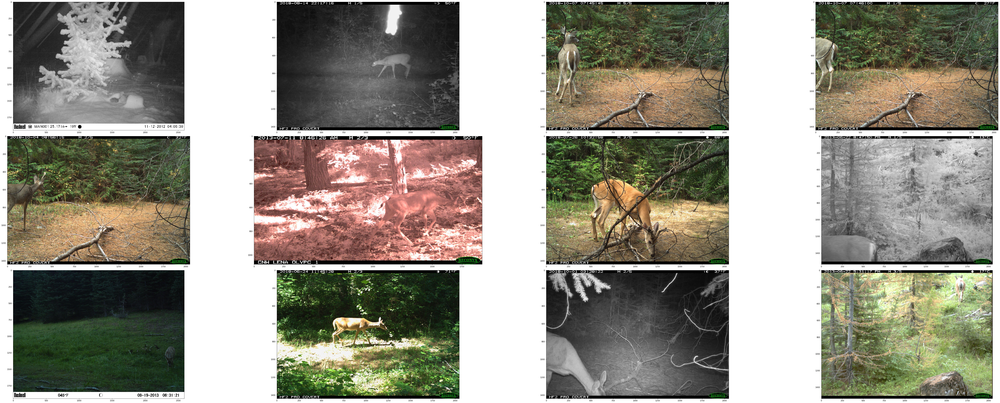

In [60]:
# Visualizing the first 12 images.
OUTPUT_PATH = 'tlt_infer_testing/labels' # relative path from $USER_EXPERIMENT_DIR.
COLS = 4 # number of columns in the visualizer grid.
IMAGES = 12 # number of images to visualize.

visualize_images(OUTPUT_PATH, num_cols=COLS, num_images=IMAGES)

## 10. Deploy! <a class="anchor" id="head-10"></a>

In [ ]:
!tlt-export $USER_EXPERIMENT_DIR/experiment_dir_retrain/weights/resnet18_detector_pruned.tlt \
            -o $USER_EXPERIMENT_DIR/experiment_dir_final/resnet18_detector.etlt \
            --outputs output_cov/Sigmoid,output_bbox/BiasAdd \
            --enc_key $API_KEY \
            --input_dims 3,320,496 \
            --max_workspace_size 1100000

In [ ]:
print('Exported model:')
print('------------')
!ls -lh $USER_EXPERIMENT_DIR/experiment_dir_final